In [1]:
import os, sys, time, tqdm, importlib, pickle
import numpy as np
import pandas as pd
import pathlib
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import style
import seaborn as sns
import scanpy as sc
import spatialdata as sd
import squidpy as sq
import scipy.stats as ss
from scipy.spatial.distance import cdist
import gseapy

import warnings
warnings.filterwarnings('ignore')

style.use('seaborn-v0_8-white')
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)

/home/xiaojiashun/anaconda3/envs/SpatialScope/lib/python3.9/site-packages/dask/dataframe/_pyarrow_compat.py:15: FutureWarning: Minimal version of pyarrow will soon be increased to 14.0.1. You are using 9.0.0. Please consider upgrading.
  warnings.warn(


In [2]:
## ct map
ct_map = {'B_GC': ['B_Cycling', 'B_GC_DZ', 'B_GC_LZ', 'B_GC_prePB'],
          'B_mem': ['B_IFN', 'B_activated', 'B_mem', 'B_naive', 'B_preGC'],
          'B_plasma': ['B_plasma'],
          'DC': ['DC_CCR7+', 'DC_cDC1', 'DC_cDC2', 'DC_pDC'],
          'Endo': ['Endo'],
          'FDC': ['FDC'],
          'ILC': ['ILC'],
          'Macrophaeges': ['Macrophages_M1', 'Macrophages_M2'],
          'Myeloids': ['Mast', 'Monocytes'],
          'NK': ['NK'],
          'T': ['NKT', 'T_CD4+', 'T_CD4+_TfH', 'T_CD4+_TfH_GC', 'T_CD8+_CD161+', 'T_CD8+_cytotoxic', 'T_TIM3+', 'T_TfR', 'T_Treg'],
          'T_naive': ['T_CD4+_naive', 'T_CD8+_naive'],
          'Stromal': ['VSMC']}
ct_map_inv = {}
for k, v in ct_map.items():
    for x in v:
        ct_map_inv[x] = k

In [1271]:
import utils
importlib.reload(utils)
from utils import *

# Data

In [1090]:
crop_id = 3

## Preprocess

### Label and basic preprocess

In [3]:
data_dir = '/data2/xiaojiashun/niche/data/Xenium/Xenium_Prime_Human_Lymph_Node_Reactive_FFPE_outs/three_crops'

In [4]:
crop = sc.read(f'{data_dir}/crop{crop_id}_raw.h5ad')
print(f'Raw: {len(crop)} cells.')

Raw: 223757 cells.


In [5]:
crop

AnnData object with n_obs × n_vars = 223757 × 4624
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level', 'cell_labels', 'x', 'y', 'group'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [6]:
## cell type label
chunk1 = pd.read_csv(f'{data_dir}/cell2location_info_crop{crop_id}_chunk1.csv', sep='\t', index_col=0)
chunk2 = pd.read_csv(f'{data_dir}/cell2location_info_crop{crop_id}_chunk2.csv', sep='\t', index_col=0)
chunks = pd.concat([chunk1, chunk2], axis=0)
chunks.index = chunks.index.astype(str)
print(chunk1.shape, chunk2.shape, chunks.shape)
chunks['sub_cell_type'] = chunks['cell_type']
chunks['cell_type'] = chunks['sub_cell_type'].map(ct_map_inv)
obs = crop.obs.copy()
merge = pd.merge(obs, chunks[['max_abun', 'max_norm', 'cell_type', 'sub_cell_type']], 
                 left_index=True, right_index=True, how='left')
crop.obs = merge.copy()
crop.obs['cell_type'] = crop.obs['cell_type'].astype('category')
crop.obs['sub_cell_type'] = crop.obs['sub_cell_type'].astype('category')

(115000, 40) (108757, 40) (223757, 40)


In [8]:
crop.obs.groupby('cell_type').size()

cell_type
B_GC            18344
B_mem           27361
B_plasma         5576
DC              17345
Endo            20085
FDC              4320
ILC               617
Macrophaeges    19303
Myeloids         1983
NK               2246
Stromal         25878
T               29561
T_naive         51138
dtype: int64

In [9]:
## basic preprocess
np.unique(crop.obs.nucleus_count, return_counts=True)

(array([0., 1., 2., 3., 4., 5., 6.]),
 array([  2268, 206497,  13627,   1234,    118,     12,      1]))

In [10]:
sc.pp.filter_cells(crop, min_counts=100)
sc.pp.filter_cells(crop, max_counts=5000)
sc.pp.filter_genes(crop, min_cells=5)
crop

AnnData object with n_obs × n_vars = 201631 × 4623
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level', 'cell_labels', 'x', 'y', 'group', 'max_abun', 'max_norm', 'cell_type', 'sub_cell_type', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

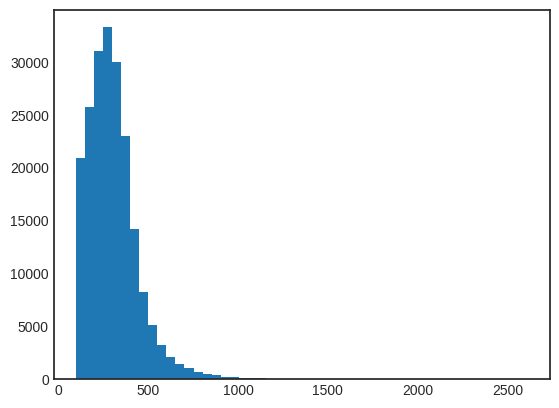

In [11]:
plt.hist(np.array(crop.X.sum(1))[:,0], bins=50)
plt.show()

In [12]:
np.median(np.array(crop.X.sum(1))[0])

477.0

In [13]:
crop.raw = crop
crop.layers['counts'] = crop.X.copy()
t0 = time.time()
sc.pp.normalize_total(crop)
sc.pp.highly_variable_genes(crop, flavor='seurat_v3',n_top_genes=3000)
sc.pp.log1p(crop)
sc.pp.pca(crop, svd_solver='arpack', n_comps=30, use_highly_variable=True)
sc.pp.neighbors(crop, metric='cosine', n_neighbors=30, n_pcs = 30)
sc.tl.umap(crop)
print(f'{time.time() - t0:.1f}s')

141.8s


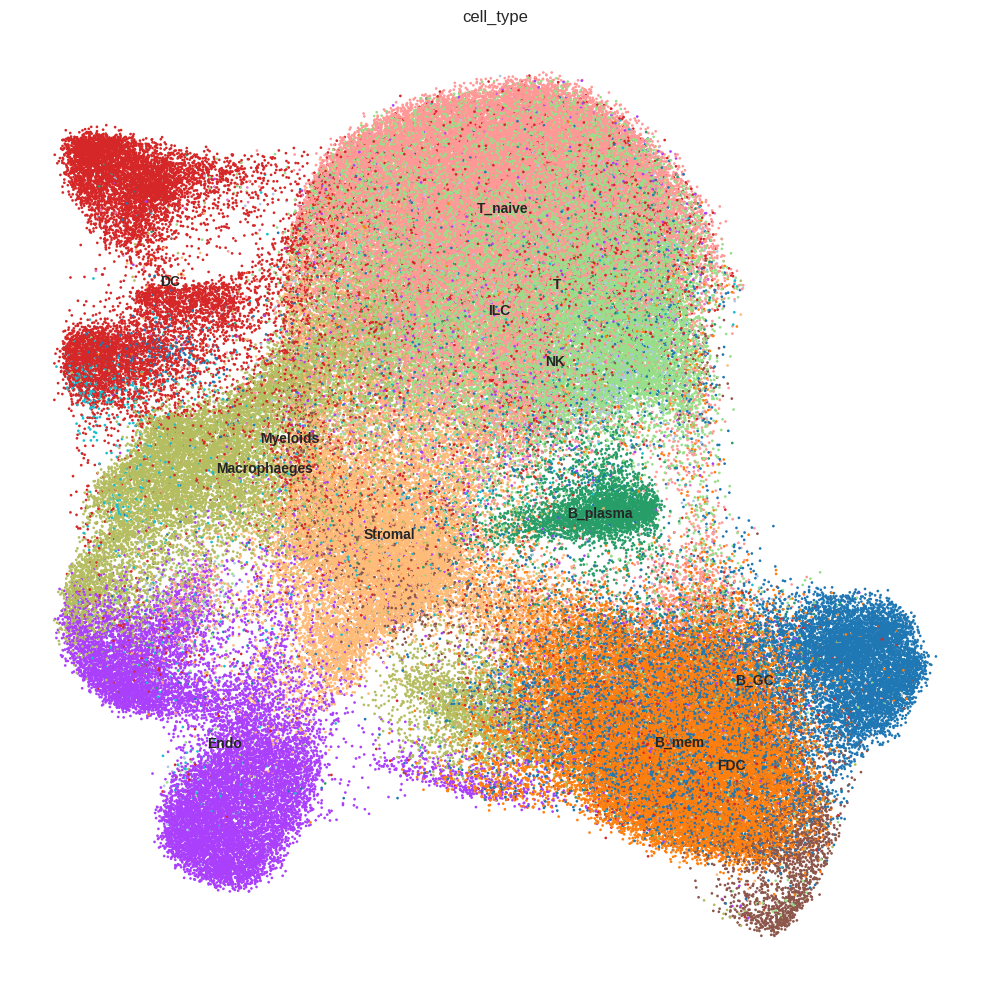

In [14]:
fig, axs = plt.subplots(1, 1, figsize=(10, 10))
sc.pl.umap(crop,  size=15, color='cell_type', frameon=False, show=False, ax=axs,legend_loc='on data')
plt.tight_layout()

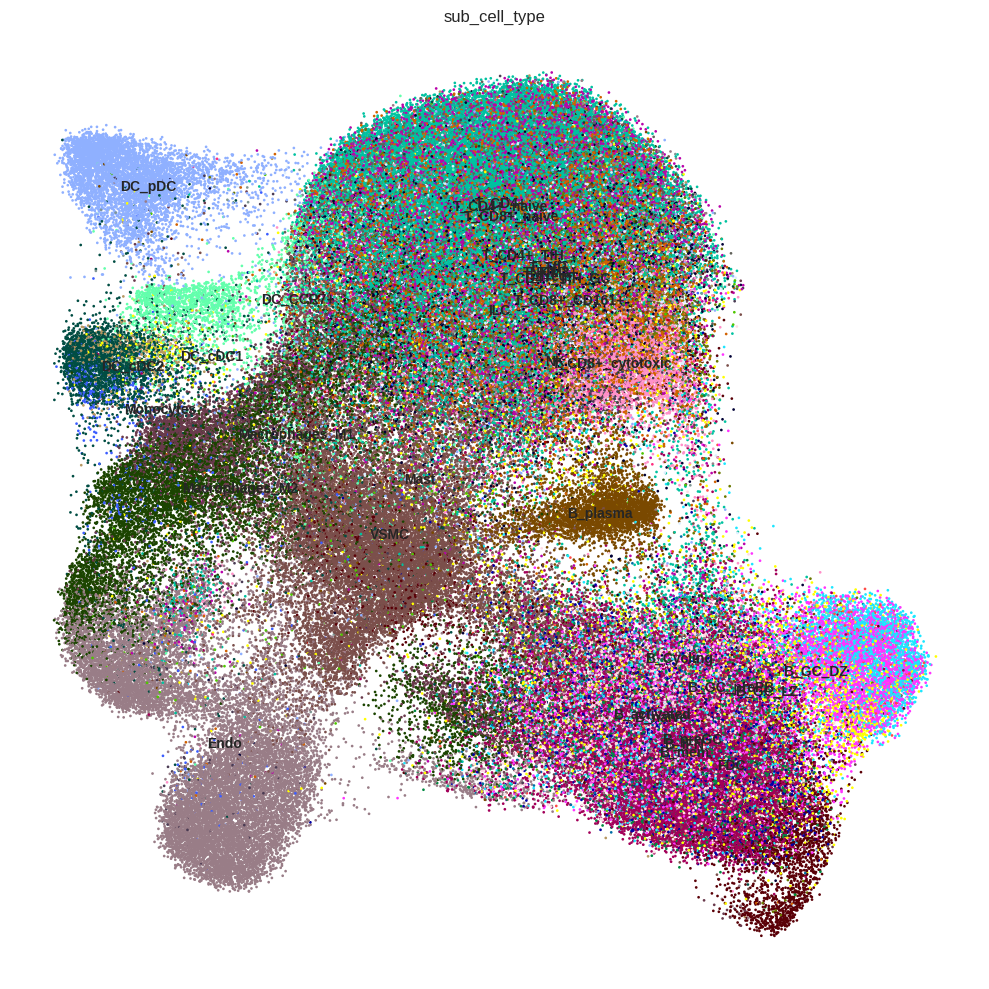

In [15]:
fig, axs = plt.subplots(1, 1, figsize=(10, 10))
sc.pl.umap(crop,  size=15, color='sub_cell_type', frameon=False, show=False, ax=axs,legend_loc='on data')
plt.tight_layout()

In [16]:
crop.X.max(), crop.layers['counts'].max()

(3.882561, 175.0)

In [17]:
print(f'After basic preprocessing: {len(crop)} cells.')

After basic preprocessing: 201631 cells.


In [18]:
## save crop after prepro
crop.write(f'{data_dir}/crop{crop_id}_prepro.h5ad')

### QC

In [1091]:
## load crop with prepro
crop = sc.read(f'{data_dir}/crop{crop_id}_prepro.h5ad')
print(f'Before QC: {len(crop)} cells.')

Before QC: 201631 cells.


In [1092]:
## qc by label confidence
conf = 0.3
obs = crop.obs.copy()
qc_df = obs.loc[obs['max_norm']>conf]
qc_df = qc_df.groupby('cell_type').filter(lambda x: len(x) >= 100)
qc_df = qc_df.groupby('sub_cell_type').filter(lambda x: len(x) >= 100)
obs['pass_qc'] = False
obs.loc[qc_df.index,'pass_qc'] = True
crop.obs = obs.copy()
crop = crop[crop.obs.pass_qc==True,:]
# crop = crop[crop.obs.cell_type!='VSMC']
print(f'After QC: {len(crop)} cells.')

After QC: 95969 cells.


In [654]:
## save crop after qc
crop.write(f"{data_dir}/crop{crop_id}_conf{str(conf).replace('.','')}.h5ad")

## QC summary

In [1093]:
all_cts = crop.obs.cell_type.cat.categories
crop.obs.groupby('cell_type')['max_norm'].agg(['size', 'median'])

,size,median
cell_type,,
B_GC,10574,0.572113
B_mem,11403,0.467982
B_plasma,3596,0.747994
DC,12112,0.724029
Endo,14146,0.756436
FDC,2162,0.477634
ILC,247,0.516459
Macrophaeges,10902,0.526071
Myeloids,1051,0.616222


In [1094]:
all_subcts = crop.obs.sub_cell_type.cat.categories
print(len(all_subcts))
crop.obs.groupby('sub_cell_type')['max_norm'].agg(['size', 'median'])

31


,size,median
sub_cell_type,,
B_Cycling,2279,0.508184
B_GC_DZ,3017,0.612786
B_GC_LZ,5027,0.593685
B_GC_prePB,251,0.431771
B_IFN,1027,0.412800
B_activated,239,0.374237
B_mem,7748,0.495769
B_naive,1435,0.423028
B_plasma,3596,0.747994


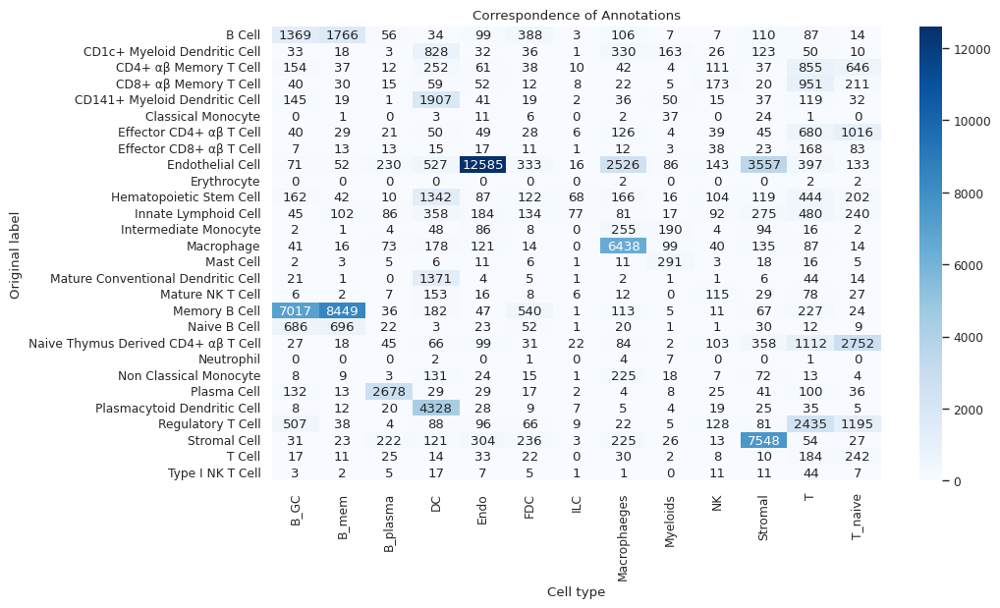

In [1095]:
# Create a contingency matrix
contingency_matrix = pd.crosstab(crop.obs['group'],crop.obs['cell_type'])

# Plotting the heatmap
plt.figure(figsize=(10, 6), dpi=100)
sns.heatmap(contingency_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Correspondence of Annotations')
plt.xlabel('Cell type')
plt.ylabel('Original label')
plt.show()

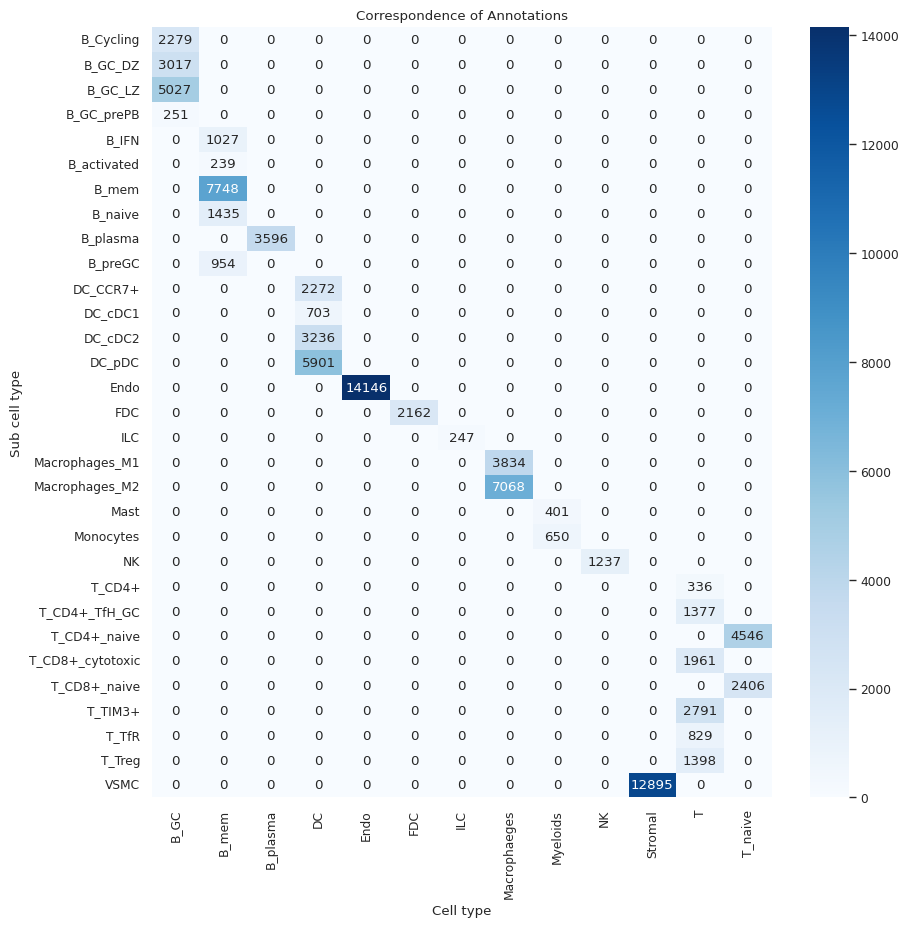

In [1096]:
# Create a contingency matrix
contingency_matrix = pd.crosstab(crop.obs['sub_cell_type'],crop.obs['cell_type'])

# Plotting the heatmap
plt.figure(figsize=(10, 10), dpi=100)
sns.heatmap(contingency_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Correspondence of Annotations')
plt.xlabel('Cell type')
plt.ylabel('Sub cell type')
plt.show()

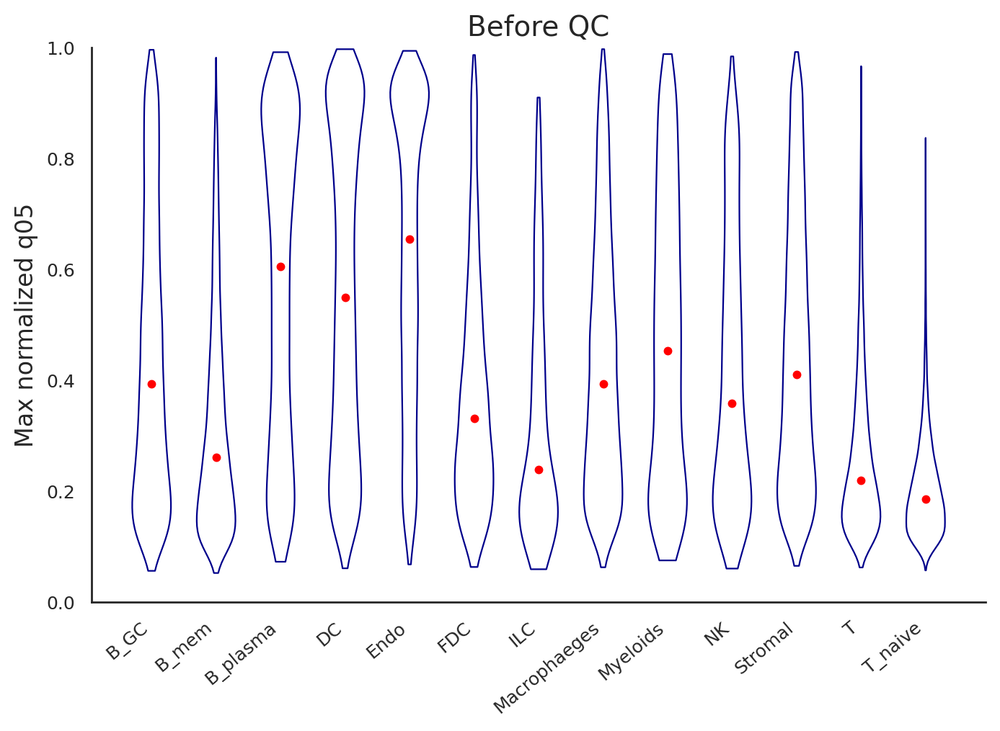

In [1100]:
sns.set_theme(style='white')
sns.set_context('paper',font_scale=1)
fig, ax = plt.subplots(1, 1, figsize=(8, 5), dpi=200)
width = 0.6
df = chunks[['cell_type', 'max_norm']].copy()
xticks = df.groupby('cell_type').median().index.values
for i, k in enumerate(xticks):
    v_plot = df.loc[df.cell_type==k,'max_norm'].values
    vio1 = ax.violinplot(v_plot, positions=[i], widths=width, 
                         showextrema=False, showmedians=False,showmeans=False)
    for pc in vio1['bodies']:
        pc.set_facecolor('none')
        pc.set_edgecolor('darkblue')
        pc.set_alpha(1)
    means = np.mean(v_plot)
    quartile1, medians, quartile3 = np.percentile(v_plot, [25, 50, 75])
    ax.scatter([i], [medians], marker='o', color='red', s=12, zorder=4)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_ylabel('Max normalized q05', fontsize=12)
ax.set_xticks(range(len(xticks)))
ax.set_xticklabels(xticks, rotation=40, ha='right')
ax.set_title('Before QC', fontsize=14)
ax.set_ylim((0,1))
ax.tick_params(axis='both', which='major', labelsize=9)

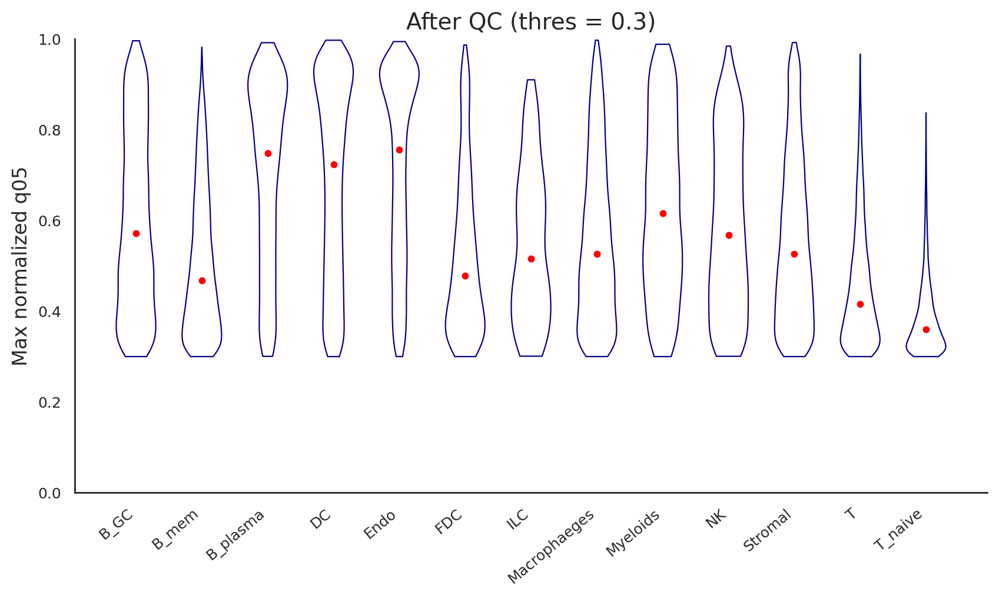

In [1099]:
sns.set_theme(style='white')
sns.set_context('paper',font_scale=1)
fig, ax = plt.subplots(1, 1, figsize=(10, 5), dpi=200)
width = 0.6
df = qc_df[['cell_type', 'max_norm']].copy()
xticks = df.groupby('cell_type').median().index.values
# xticks = df.groupby('cell_type').median().sort_values('max', ascending=False).index.values
for i, k in enumerate(xticks):
    v_plot = df.loc[df.cell_type==k,'max_norm'].values
    vio1 = ax.violinplot(v_plot, positions=[i], widths=width, 
                         showextrema=False, showmedians=False,showmeans=False)
    for pc in vio1['bodies']:
        pc.set_facecolor('none')
        pc.set_edgecolor('darkblue')
        pc.set_alpha(1)
    means = np.mean(v_plot)
    quartile1, medians, quartile3 = np.percentile(v_plot, [25, 50, 75])
    ax.scatter([i], [medians], marker='o', color='red', s=12, zorder=4)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_ylabel('Max normalized q05', fontsize=12)
ax.set_xticks(range(len(xticks)))
ax.set_xticklabels(xticks, rotation=40, ha='right')
ax.set_ylim((0,1))
ax.set_title(f'After QC (thres = {conf})', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=9)

## Visualize

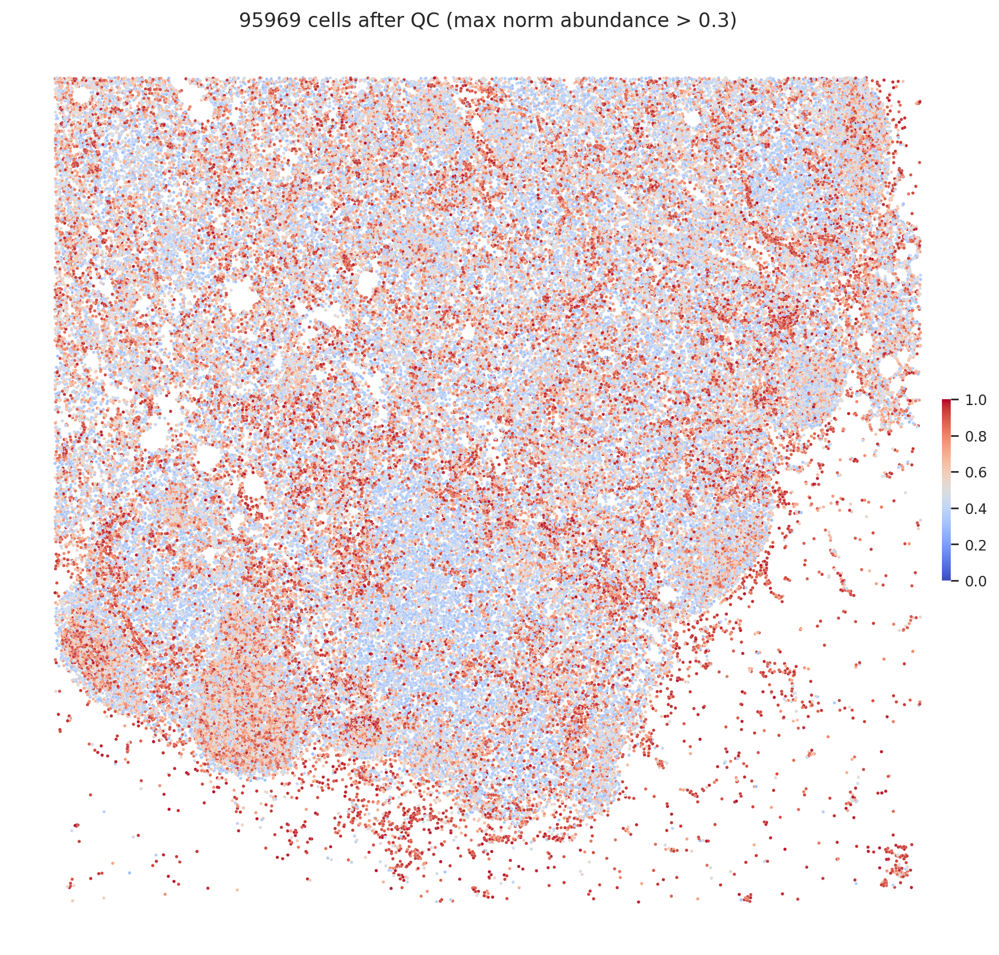

In [1101]:
fig, ax = plt.subplots(1, 1, figsize=(12, 10), dpi=200)
sca_draw = crop.obs.copy()
sca = ax.scatter(sca_draw['x'].values, sca_draw['y'].values, 4, sca_draw['max_norm'].values, edgecolor='w', lw=0.1, 
           cmap=plt.cm.coolwarm, vmin=0, vmax=1)
ax.invert_yaxis()
ax.set_xticklabels([])
ax.set_yticklabels([])
for s in ['top', 'bottom', 'right', 'left']:
    ax.spines[s].set_visible(False)
cb = fig.colorbar(sca, shrink=0.2, drawedges=False, pad=-0.02)
cb.outline.set_visible(False)
ax.set_title(f'{len(sca_draw)} cells after QC (max norm abundance > {conf})', fontsize=12)
plt.axis('off')
plt.show()

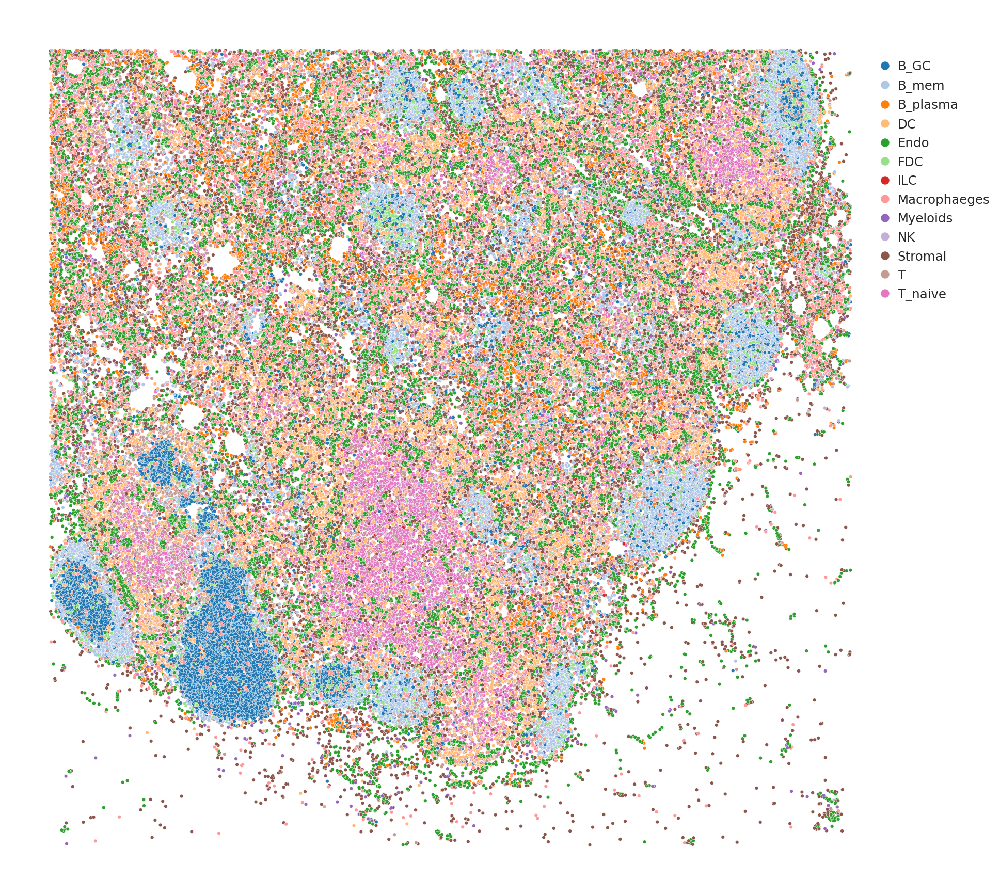

In [1102]:
## all cells
plt.subplots(figsize=(11,11), dpi=200)
cts = all_cts
sns.scatterplot(data=crop.obs, x="x", y="y", hue="cell_type", hue_order=cts, s=6, palette='tab20')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

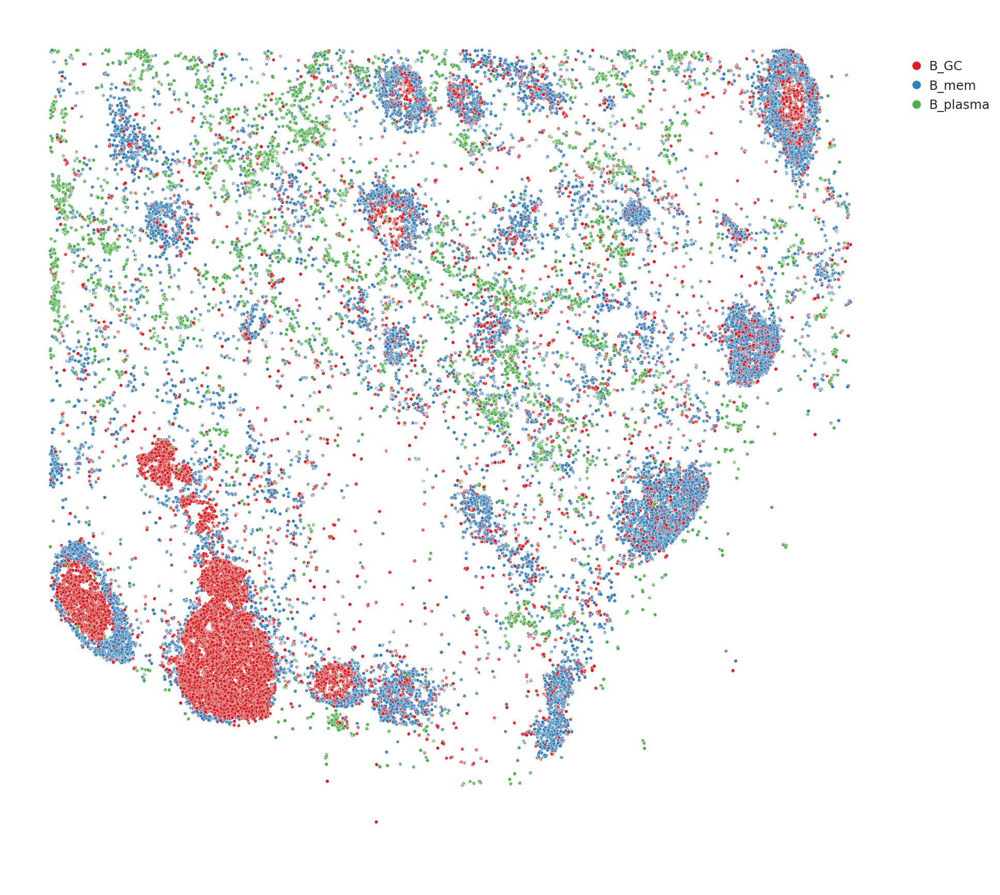

In [1103]:
## B cells
plt.subplots(figsize=(11,11), dpi=200)
cts = [x for x in all_cts if x.startswith('B_')]
sns.scatterplot(data=crop.obs, x="x", y="y", hue="cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

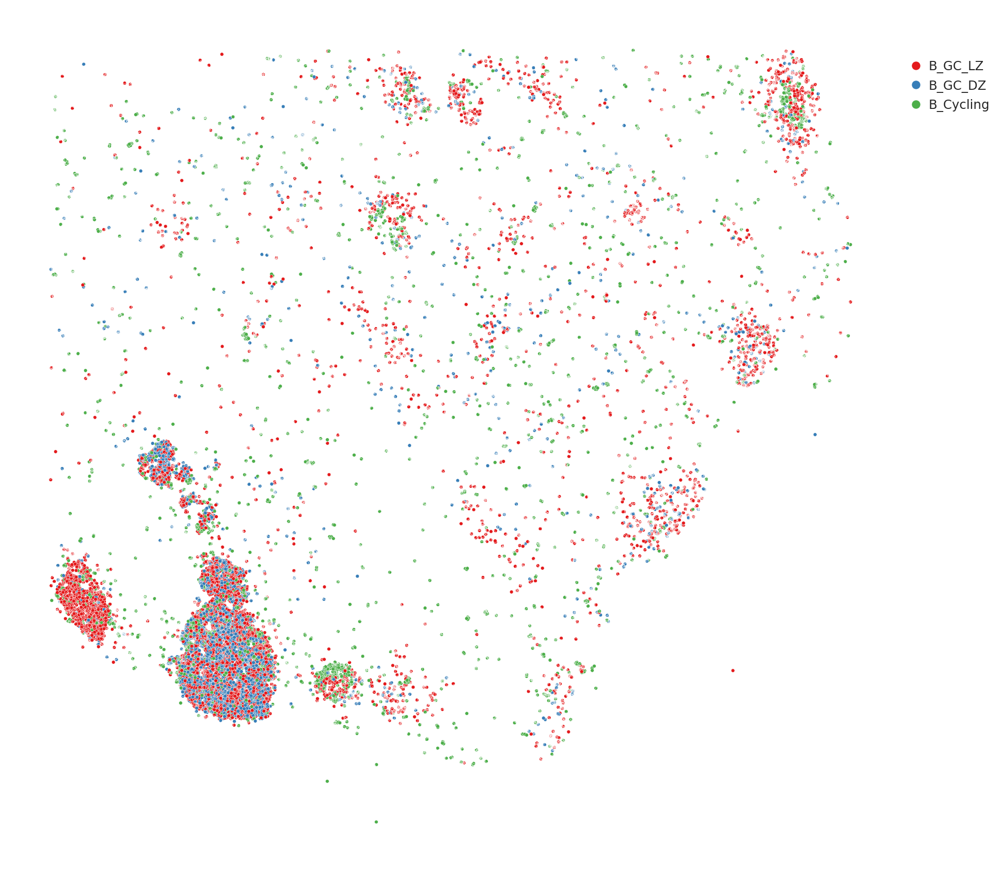

In [1104]:
## T cells
plt.subplots(figsize=(11,11), dpi=200)
cts = ['B_GC_LZ', 'B_GC_DZ', 'B_Cycling']
sns.scatterplot(data=crop.obs, x="x", y="y", hue="sub_cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

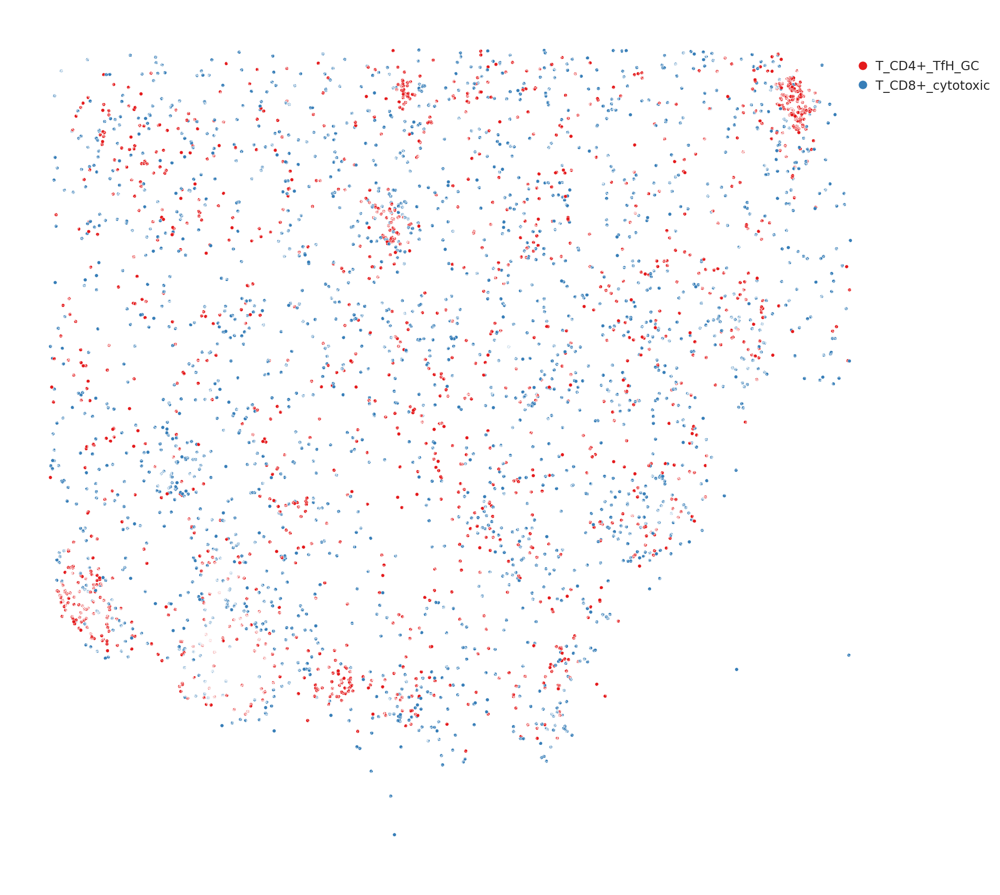

In [1105]:
## T cells
plt.subplots(figsize=(11,11), dpi=200)
cts = ['T_CD4+_TfH_GC', 'T_CD8+_cytotoxic']
sns.scatterplot(data=crop.obs, x="x", y="y", hue="sub_cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

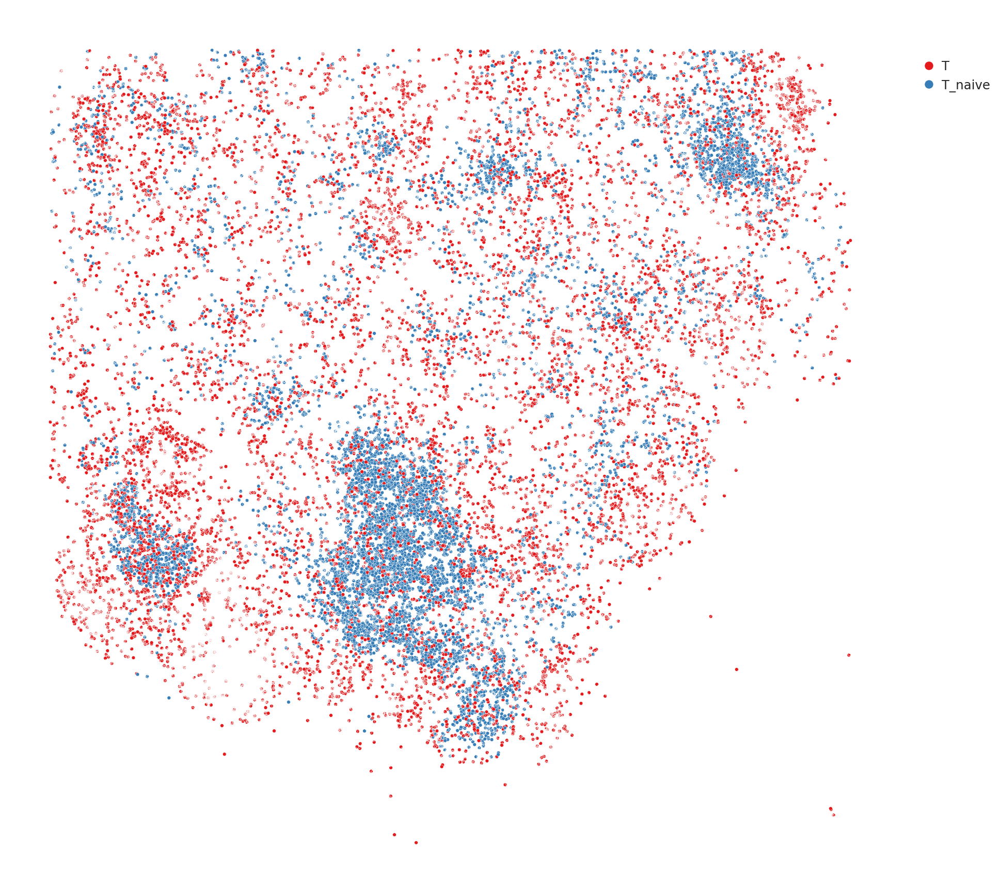

In [1106]:
## T cells
plt.subplots(figsize=(11,11), dpi=200)
cts = [x for x in all_cts if x.startswith('T')]
sns.scatterplot(data=crop.obs, x="x", y="y", hue="cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

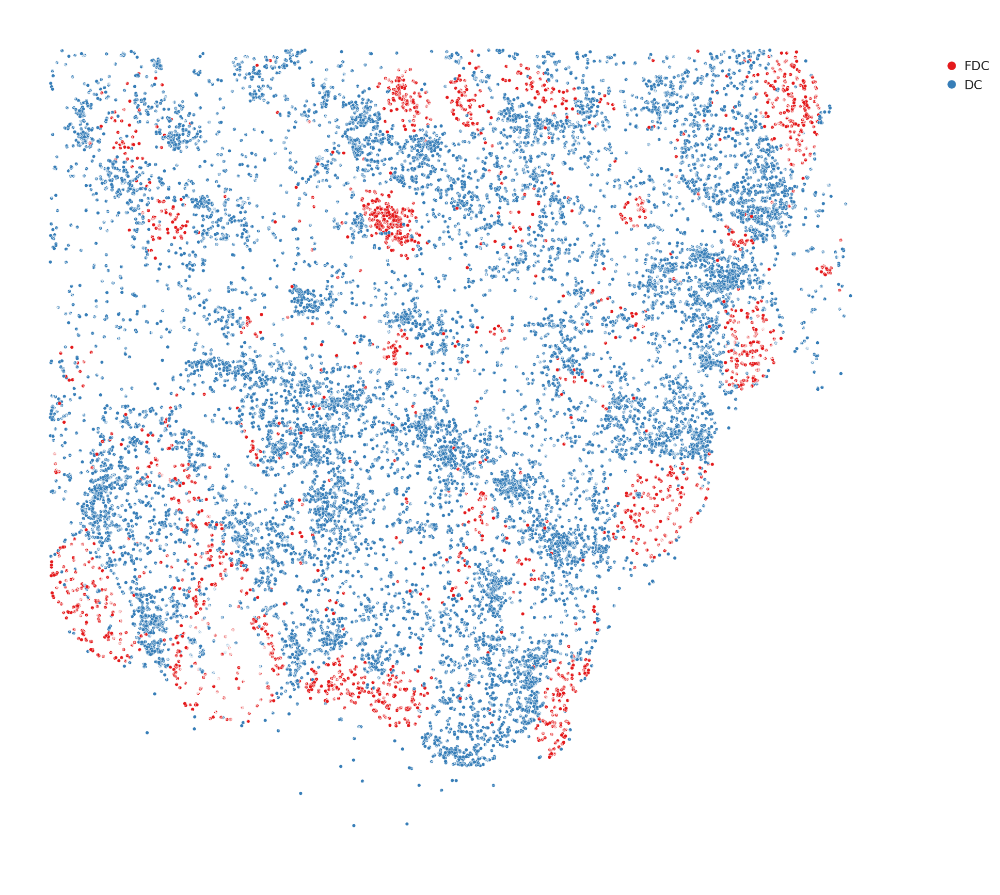

In [1107]:
## DC cells
plt.subplots(figsize=(11,11), dpi=200)
cts = ['FDC', 'DC']
sns.scatterplot(data=crop.obs, x="x", y="y", hue="cell_type", hue_order=cts, s=6, palette='Set1')
plt.legend(bbox_to_anchor=(1.12,0.95), loc="upper right",framealpha=0,markerscale=2.5)
plt.axis('off')
plt.gca().invert_yaxis()
plt.show()

# Neighborhood analysis

## Delaunay

In [1108]:
## spatial neighborhood graph
sq.gr.spatial_neighbors(crop, coord_type="generic", delaunay=True) # 2s
sq.gr.nhood_enrichment(crop, cluster_key="cell_type")


00%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:02<00:00, 397.67/s]

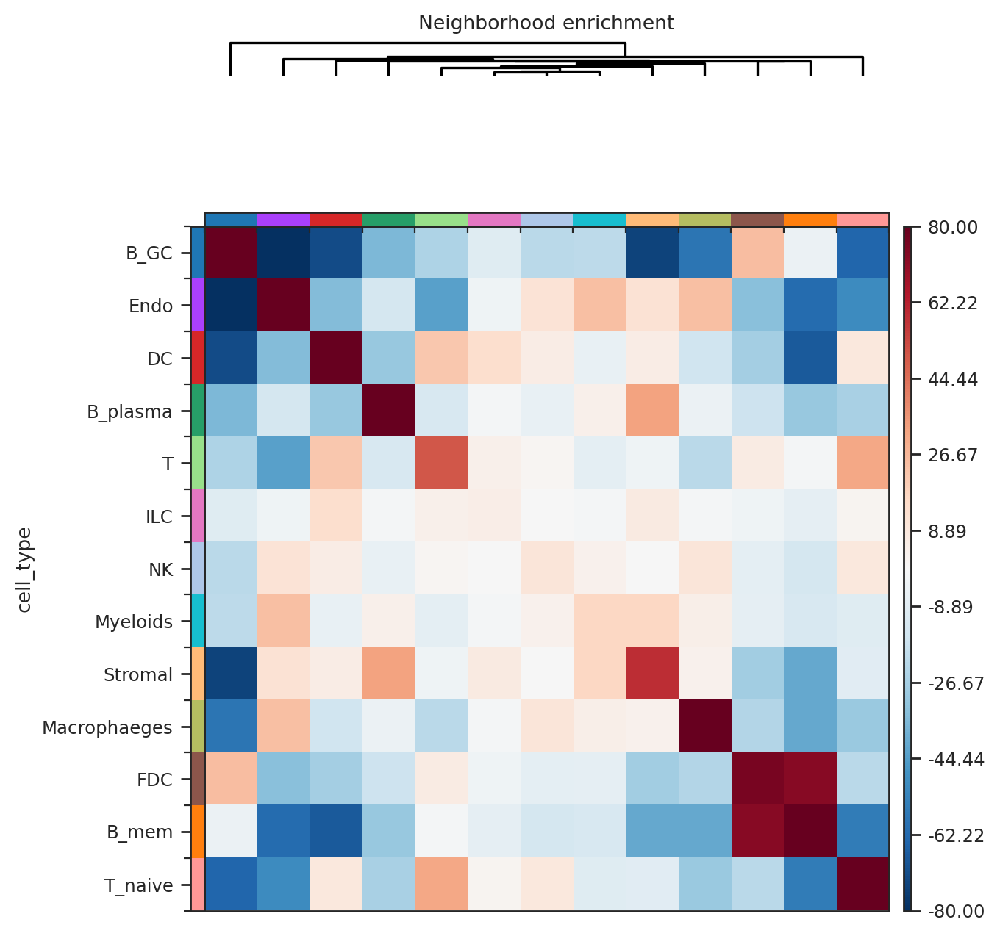

In [1109]:
## delaunay
v_ = np.abs(np.array(crop.uns['cell_type_nhood_enrichment']['zscore'])).max()
sq.pl.nhood_enrichment(crop, cluster_key="cell_type", method='single', 
                       figsize=(6, 6), cmap='RdBu_r', vmin=-80, vmax=80)

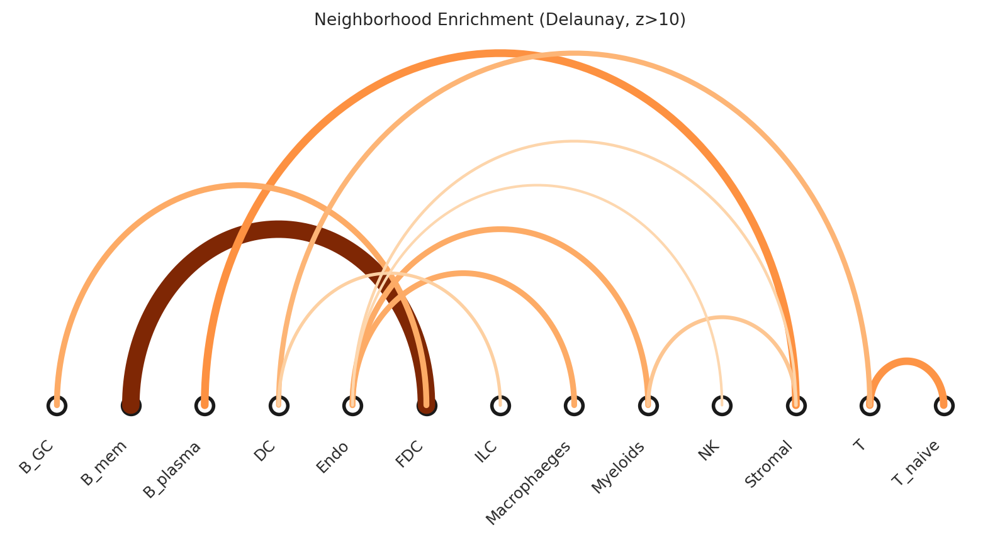

In [1110]:
## enriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = 10
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel > zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], zscore[i,j]]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Oranges', figsize=(10, 4), title=f'Neighborhood Enrichment (Delaunay, z>{zs_thres})')

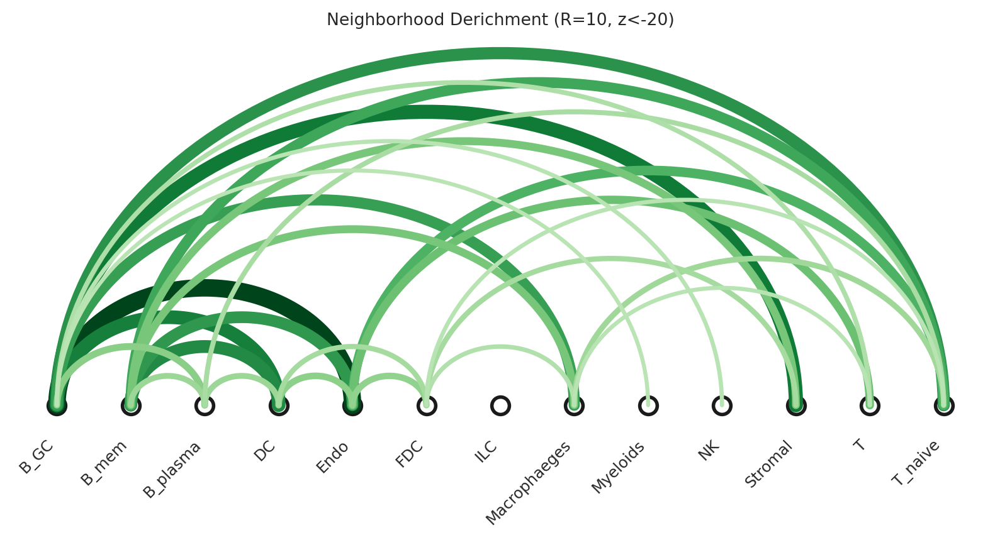

In [1111]:
## deriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = -20
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel < zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], abs(zscore[i,j])]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Greens', figsize=(10, 4), title=f'Neighborhood Derichment (R=10, z<{zs_thres})')

## R=10

In [1112]:
## spatial neighborhood graph
sq.gr.spatial_neighbors(crop, coord_type="generic", radius=10)
sq.gr.nhood_enrichment(crop, cluster_key="cell_type")


00%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:02<00:00, 414.98/s]

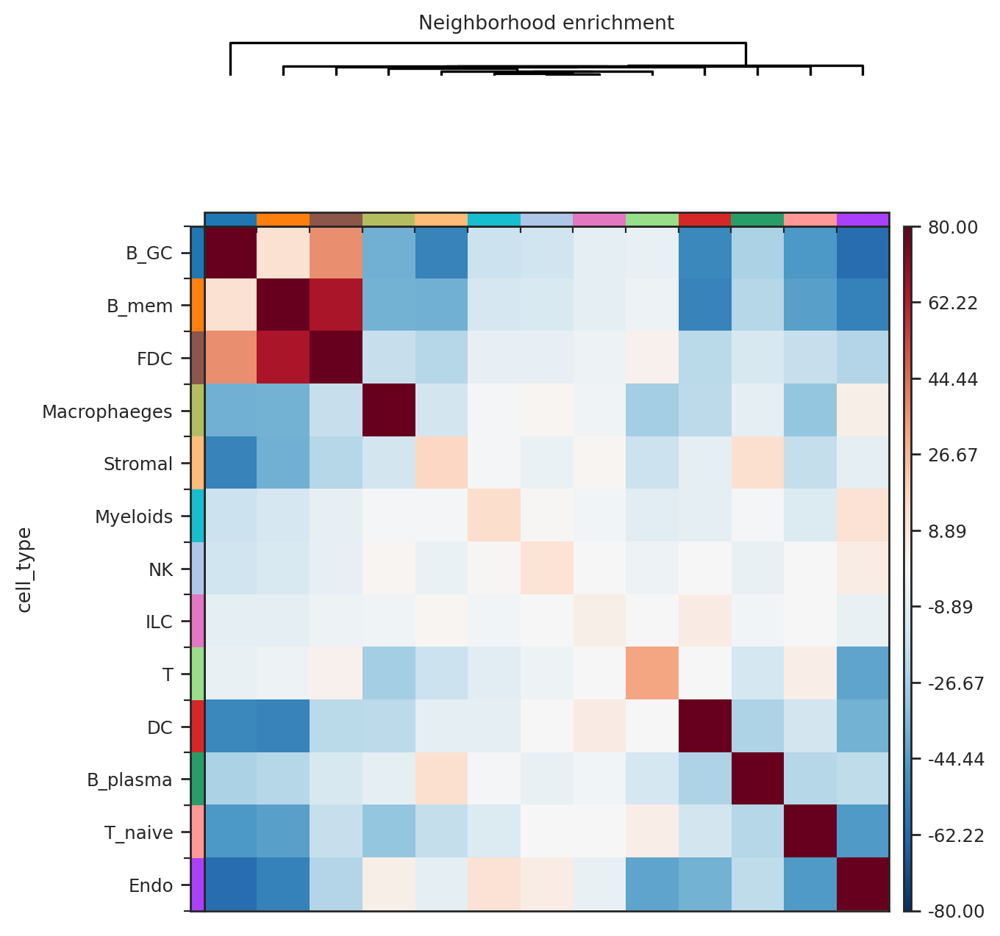

In [1113]:
## radius=10
v_ = np.abs(np.array(crop.uns['cell_type_nhood_enrichment']['zscore'])).max()
sq.pl.nhood_enrichment(crop, cluster_key="cell_type", method='single', 
                       figsize=(6, 6), cmap='RdBu_r', vmin=-80, vmax=80)

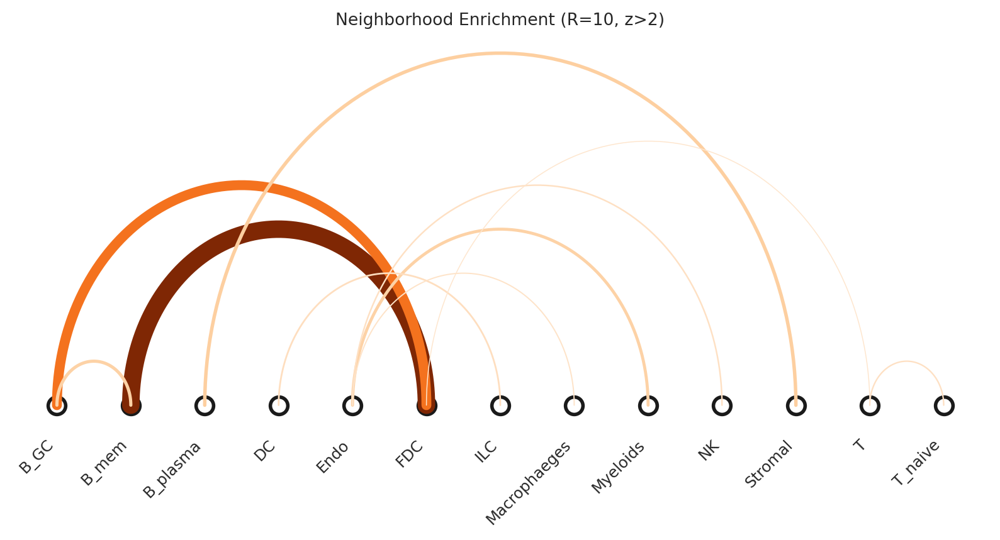

In [1114]:
## enriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = 2
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel > zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], zscore[i,j]]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Oranges', figsize=(10, 4), title=f'Neighborhood Enrichment (R=10, z>{zs_thres})')

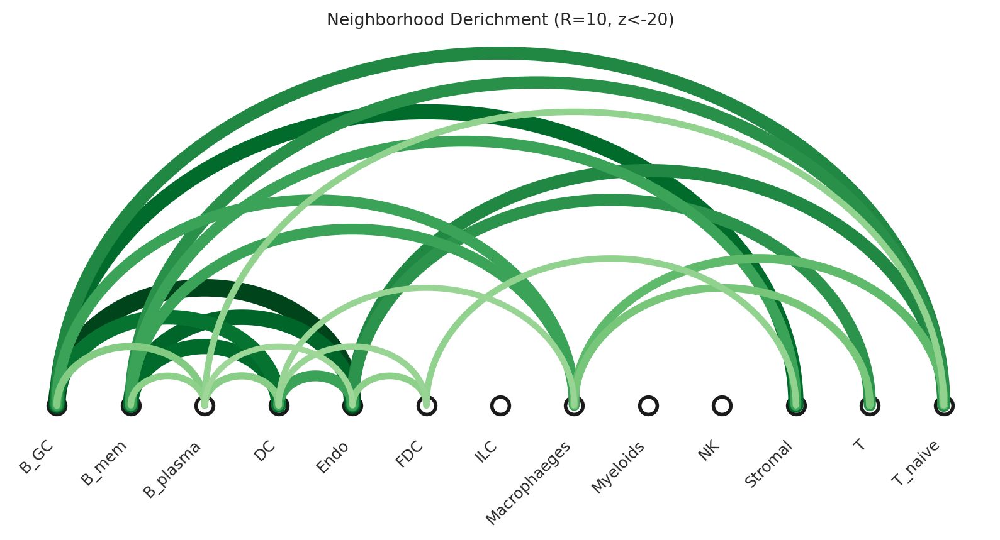

In [1115]:
## deriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = -20
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel < zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], abs(zscore[i,j])]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Greens', figsize=(10, 4), title=f'Neighborhood Derichment (R=10, z<{zs_thres})')

## R=20

In [1116]:
## spatial neighborhood graph
sq.gr.spatial_neighbors(crop, coord_type="generic", radius=20)
sq.gr.nhood_enrichment(crop, cluster_key="cell_type")


00%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:02<00:00, 348.68/s]

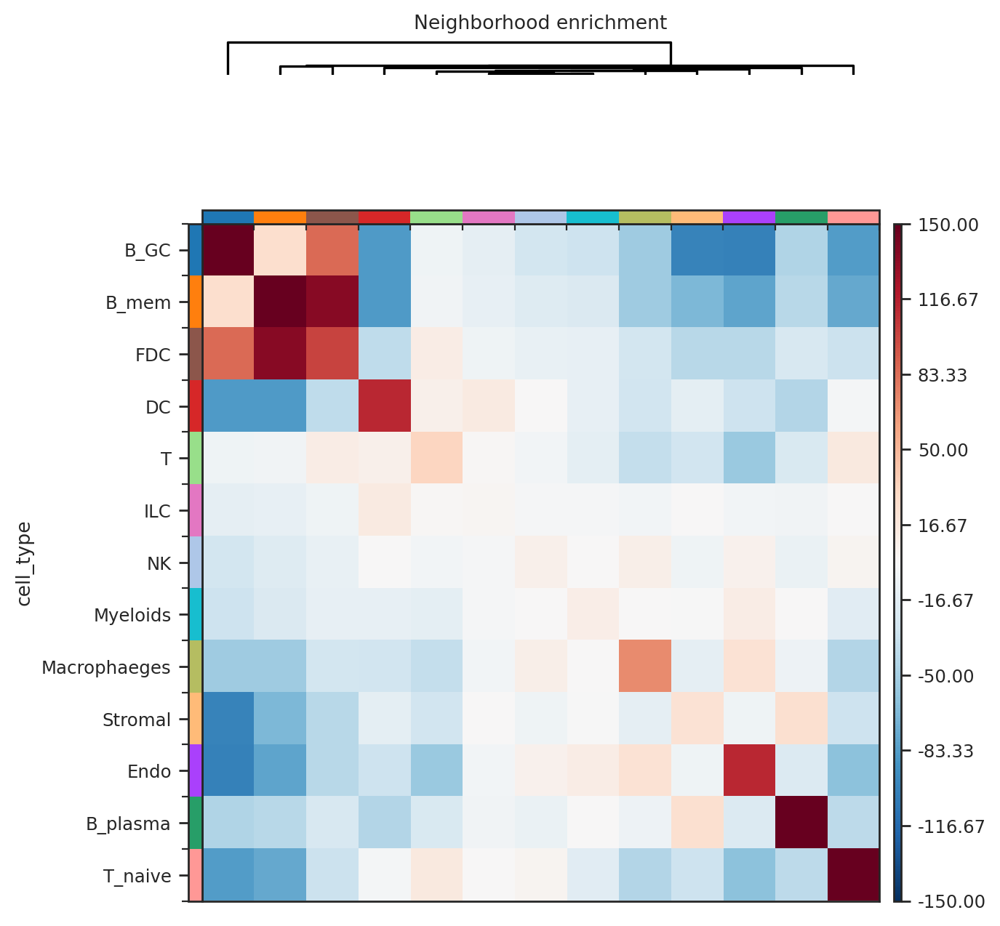

In [1117]:
## radius=20
v_ = np.abs(np.array(crop.uns['cell_type_nhood_enrichment']['zscore'])).max()
sq.pl.nhood_enrichment(crop, cluster_key="cell_type", method='single', 
                       figsize=(6, 6), cmap='RdBu_r', vmin=-150, vmax=150)

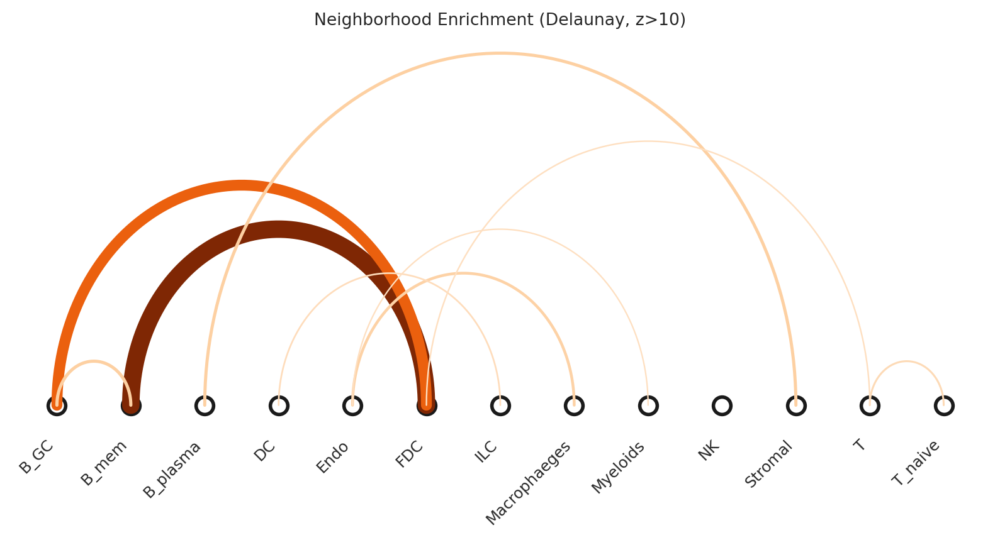

In [1118]:
## enriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = 10
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel > zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], zscore[i,j]]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Oranges', figsize=(10, 4), title=f'Neighborhood Enrichment (Delaunay, z>{zs_thres})')

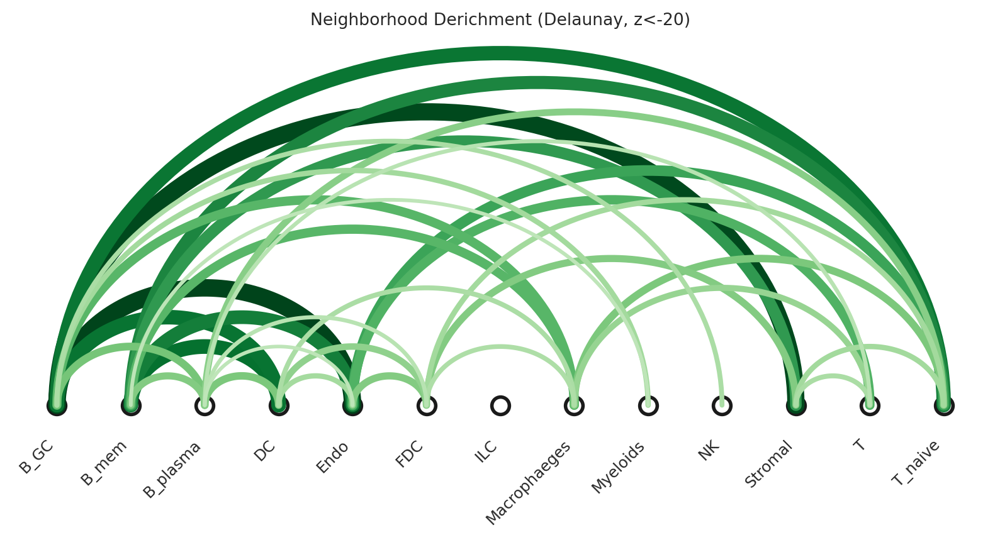

In [1119]:
## deriched
nodes = list(crop.obs.cell_type.cat.categories)
groups = list(crop.obs.cell_type.cat.categories)
zscore = crop.uns['cell_type_nhood_enrichment']['zscore']
zscorel = np.tril(zscore, k=-1)
zs_thres = -20
# zs_thres = ss.norm.ppf(0.975)
binl = (zscorel < zs_thres).astype('int')
nhood_df = pd.DataFrame(columns=['from', 'to', 'weights'])
n = 0
for i in range(binl.shape[0]):
    for j in range(i):
        if binl[i,j] == 1:
            nhood_df.loc[n] = [groups[i], groups[j], abs(zscore[i,j])]
            n += 1
nhood_df = nhood_df.sort_values('weights', ascending=False).reset_index(drop=True)
draw_arcplot(nodes, nhood_df, cmap='Greens', figsize=(10, 4), title=f'Neighborhood Derichment (Delaunay, z<{zs_thres})')

# Result

In [1121]:
save_dir = f"/data2/xiaojiashun/niche/result/Xenium/lymph-trans-label-3crop/subct_conf{str(conf).replace('.','')}"
save_dir

'/data2/xiaojiashun/niche/result/Xenium/lymph-trans-label-3crop/subct_conf03'

## T

In [1274]:
## run method
target_ct = 'T'
target_ct_abbr = target_ct
use_cov_test_genes = True
udf, vdf, meta = run_method(crop, target_ct,  target_ct_abbr, self=True,
                       sigma=20, cutoff=0.05, sort_comp_by_corr=False,
                       n_hvg=3000, cov_thres=0.05, cov_test_null=True,
                       use_cov_test_genes=use_cov_test_genes,
                       cca_comp=10, px=0.6, pz=0.4)

***** Niche matrix *****
13 cell_types.
num_cell_ID: (95969, 13).
Use other 13 cell types.
8692 T, 95969 cells in total.

***** Cov test *****
sparkx_X: (2995, 8692); sparkx_N: (8692, 13)
2994 / 2995 genes have pvalue.
Cov test on permuted data...
547 genes with p_adj < 0.05.
Use all 547 genes with p_adj < 0.05.

***** CCA *****
cca_X: (8692, 547); cca_N: (8692, 13)
Nonneg CCA cors: [0.662 0.422 0.518 0.416 0.261 0.506 0.384 0.211 0.317 0.381]
udf: (547, 10); vdf: (13, 10).

T: Finished in 29.9s.


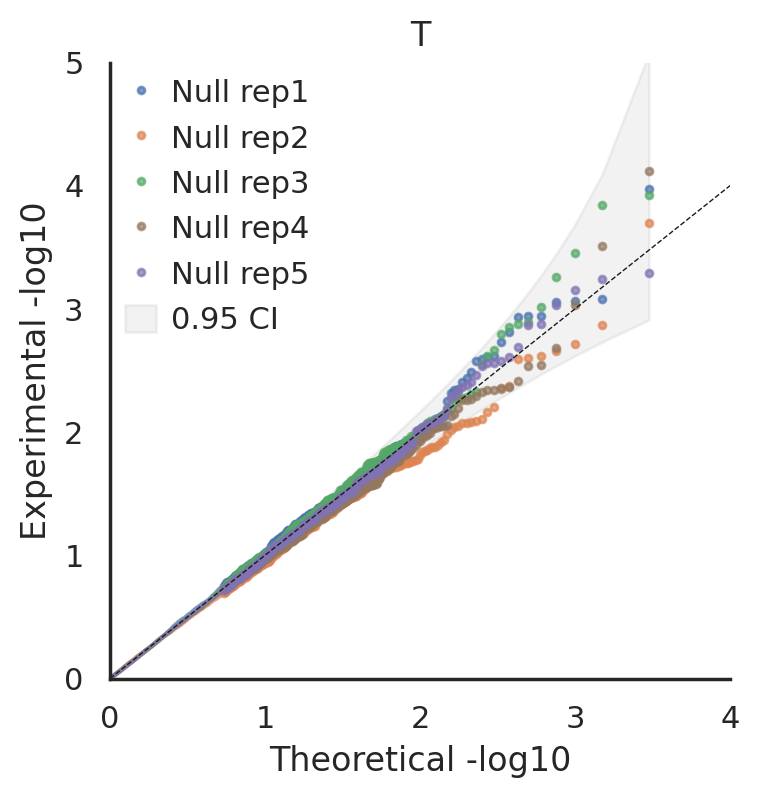

In [1275]:
## qqplot: null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'][1:], [f'Null rep{i}' for i in range(1,6)], 
       color=['C0', 'C1', 'C2', 'C5', 'C4'], shape=['.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

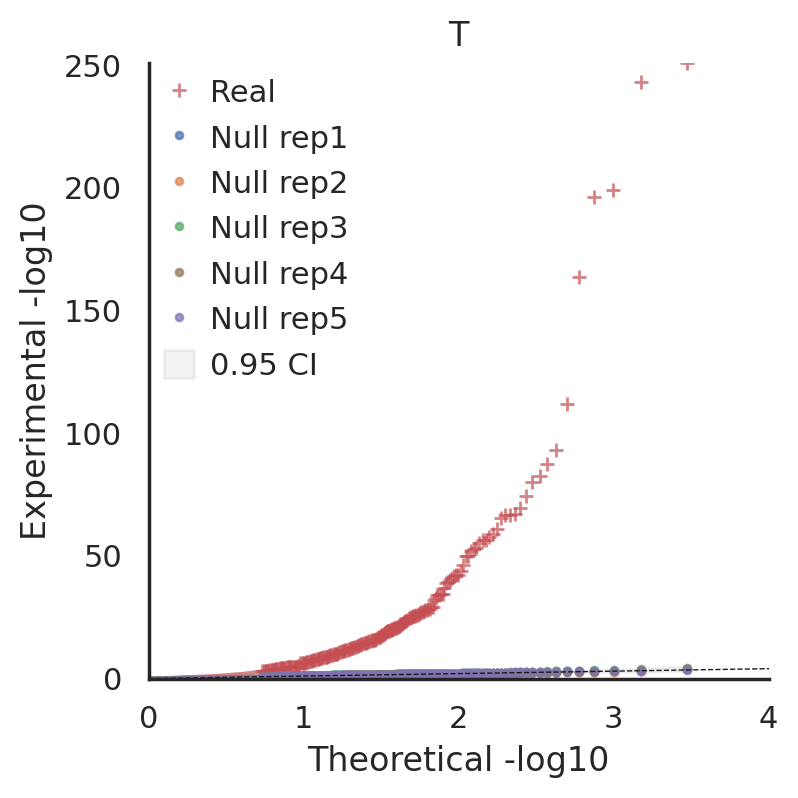

In [1276]:
## qqplot: real and null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'], ['Real']+[f'Null rep{i}' for i in range(1,6)], 
       color=['C3', 'C0', 'C1', 'C2', 'C5', 'C4'], shape=['+','.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

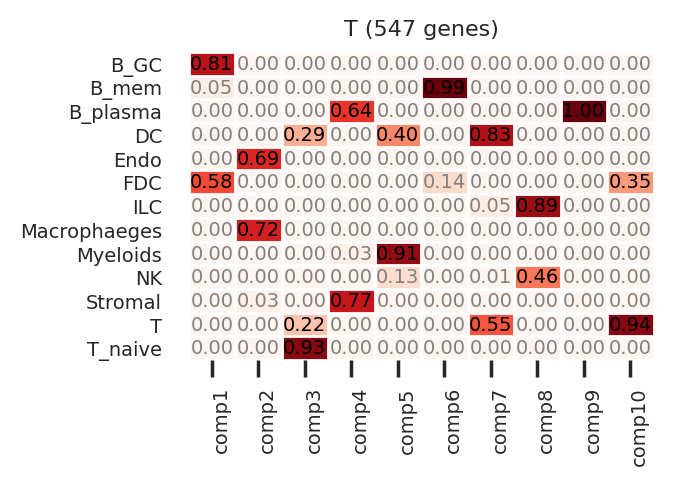

In [1125]:
## v heatmap
sns.set_theme(style="white")
draw_v_heatmap(vdf, figsize=(3,2), title=f'{target_ct} ({len(udf)} genes)')

In [1134]:
## select comps
draw_comps = [1,2,3,6]

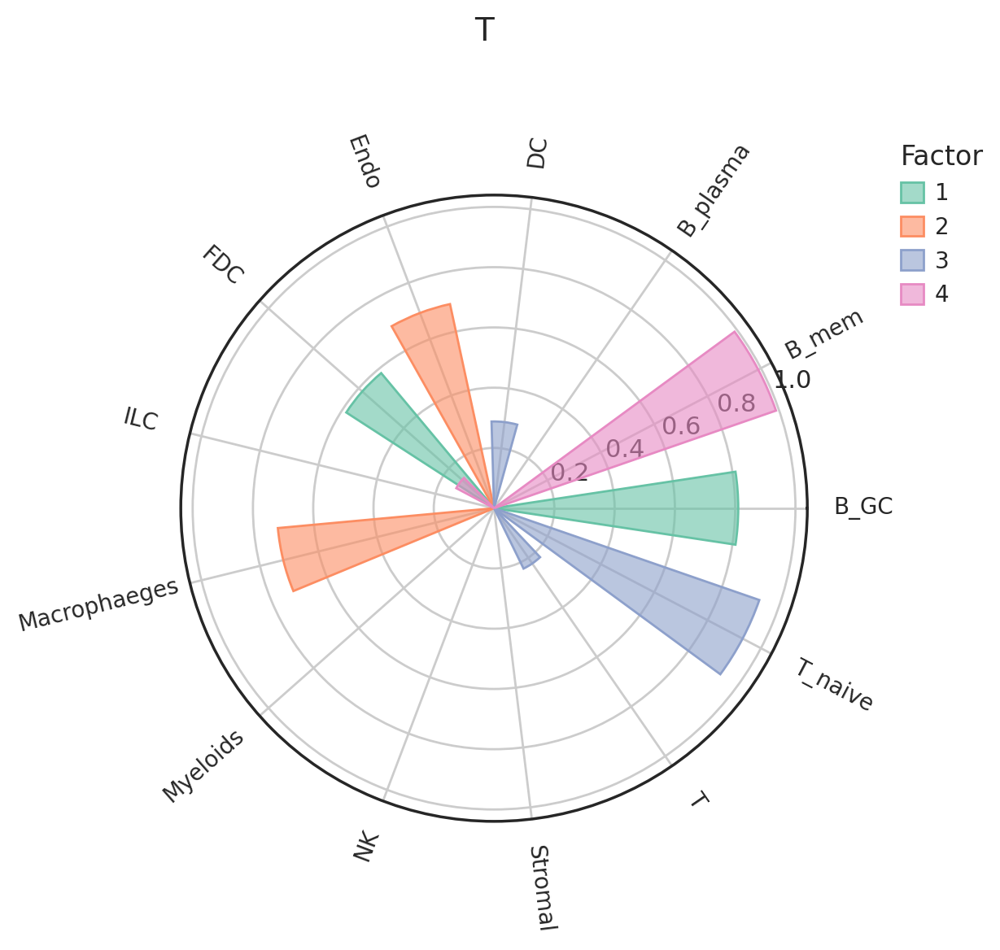

In [1135]:
## v circular
sns.set_theme(style='white')
draw_v_circular(vdf, draw_comps, v_thres=0.1, cmap=mpl.colormaps['Set2'], figsize=(5,5), dpi=200, title=target_ct)

In [1136]:
## niche scores
XY_loc_df = compute_score(crop, udf, vdf, target_ct, meta['N_target'], meta['loc_target'], meta['use_group_ids'])

Computed niche-related scores: XY_loc_df (8692, 581).


In [240]:
## save result
save_objs = {'udf': udf,
             'vdf': vdf,
             'meta': meta,
             'XY_loc_df': XY_loc_df}
filename = f'crop{crop_id}_{target_ct}.pkl'
with open(f'{save_dir}/{filename}', 'wb') as f:
    pickle.dump(save_objs, f)

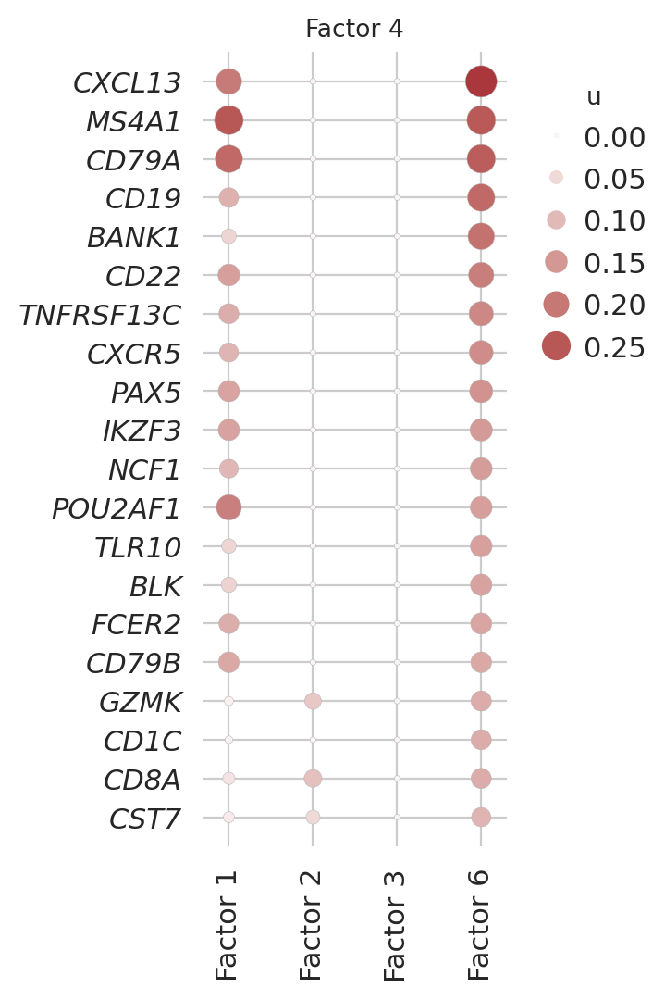

In [1158]:
## u dotmap
focus_comp = 6
n_top_gene = 20
h = 0.25 * n_top_gene
u_title = f"Factor {draw_comps.index(focus_comp)+1}"
xticklabels = [f"Factor {x}" for x in draw_comps]
draw_u_dotmap(udf, focus_comp, draw_comps, n_top_gene, (5, 150), xticklabels,
                fs=11, h=h, w=3, title=u_title, mx=0.1, my=0.04, leg_pos=(1.1,0.95), dpi=200)

In [1145]:
## kde diff: concord
kde_comp = 6
t0 = time.time()
Z, lims, draw_ids = kde_diff(XY_loc_df, kde_comp, score='concord', z_quantile=0.99, bw=20)
print(f'KDE diff: {time.time() - t0:.1f}s')

KDE diff: 72.2s


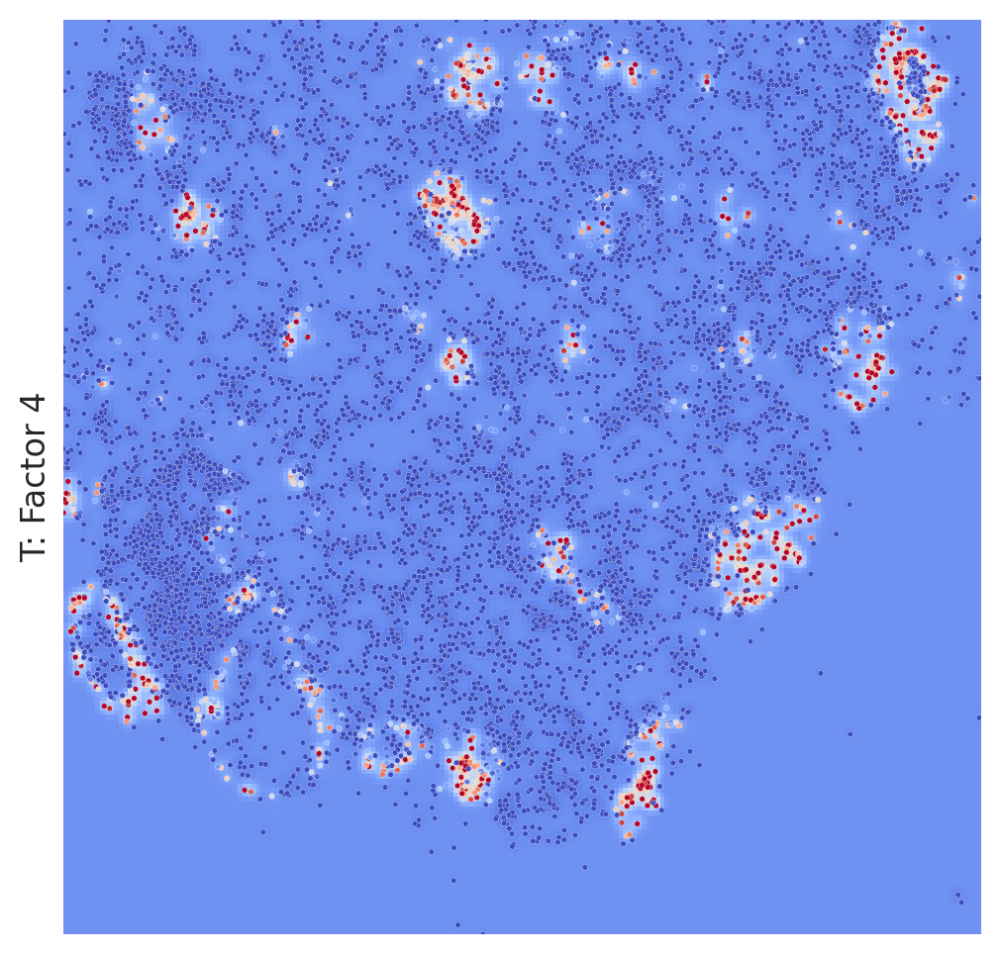

In [1146]:
## kde diff: concord
draw_kde_diff(XY_loc_df, kde_comp, target_ct, Z, lims, draw_ids, score='concord',
                  use_quant=0.99, draw_points=True, cmap=mpl.colormaps['coolwarm'], 
                  ylabel=f'{target_ct}: Factor {draw_comps.index(kde_comp)+1}', fs=12, title=None, figsize=(7, 6), dpi=200)

In [1153]:
## sub cell type count of one factor
subct_comp = 6
score_df = XY_loc_df.copy()
subcts = [x for x in score_df.sub_cell_type.unique() if x.startswith('T')]
count_df = sub_ct_enrich(subct_comp, score_df, subcts, score='concord', q1=0.9, q2=0.95)
count_df

,base,obs_high_09,obs_high_095,exp_high_09,exp_high_095,fold_09,fold_095
sub_cell_type,,,,,,,
T_CD8+_cytotoxic,1961,385,226,196,98,1.964286,2.306122
T_CD4+_TfH_GC,1377,291,135,137,68,2.124088,1.985294
T_TfR,829,37,21,82,41,0.451220,0.512195
T_Treg,1398,58,22,139,69,0.417266,0.318841
T_TIM3+,2791,99,31,279,139,0.354839,0.223022
T_CD4+,336,0,0,33,16,0.000000,0.000000


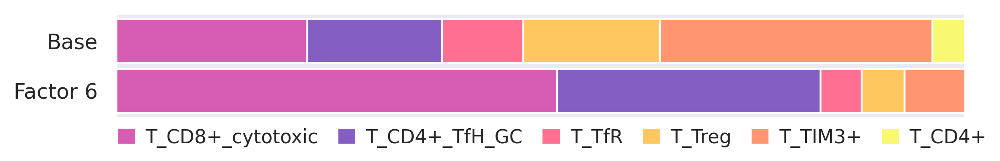

In [1154]:
## sub cell type proportion of this factor
sns.set_theme(style="darkgrid")
# colors = mpl.colormaps['Set2'].colors
color_map = {'T_CD4+_TfH_GC': '#845ec2',
             'T_CD8+_cytotoxic': '#d65db1',
             'T_TfR': '#ff6f91',
             'T_TIM3+': '#ff9671',
             'T_Treg': '#ffc75f',
             'T_CD4+': '#f9f871'}
colors = [color_map[k] for k in count_df.index.tolist()]
draw_sub_ct_prop(count_df, alphabet=False, figsize=(8,1), dpi=300, h=0.35, yticks=[0, 0.4], 
                     yticklabels=['Base', f'Factor {subct_comp}'], colors=colors, ylim=(-0.22,0.62))

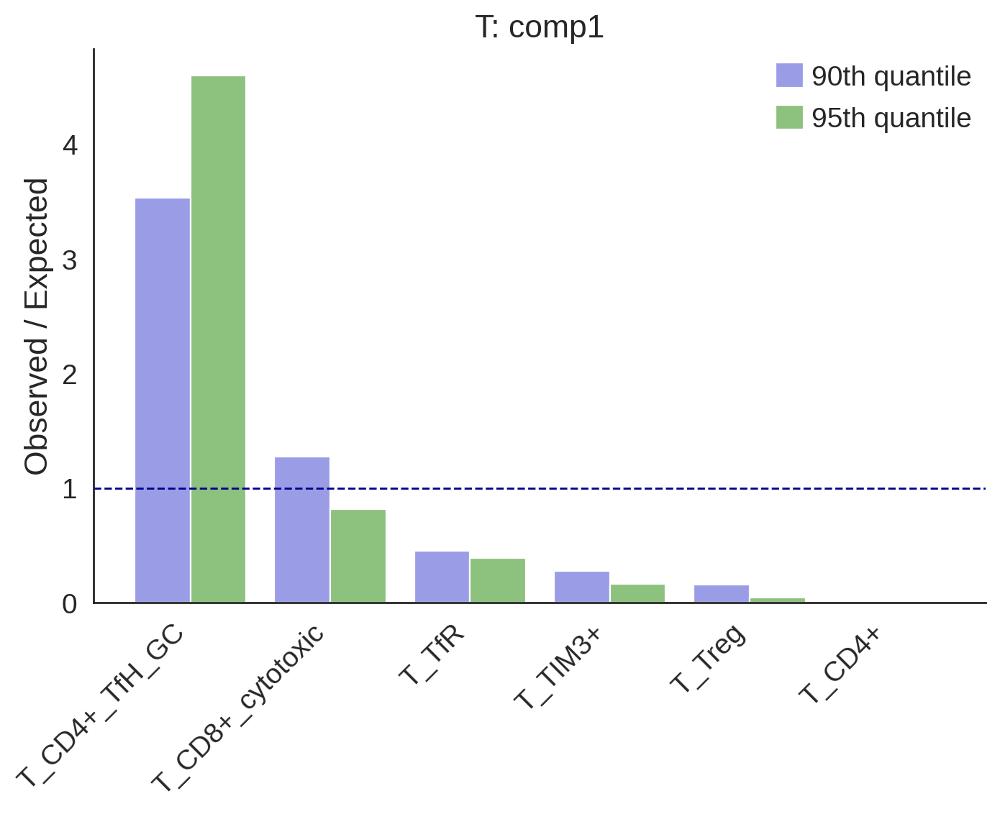

In [274]:
## enrichment folds
draw_sub_ct_enrich(count_df, figsize=(8,5), dpi=200, fs=14, width=0.4, alpha=1, title=None)

In [1137]:
## combine go results
# u_thres, u_top = [0.05, 0.05, 0.05, 0.05], None
u_thres, u_top = None, 15
wdf12 = go_combine(udf, vdf, draw_comps, u_thres=u_thres, u_top=u_top, pval_thres=0.05, n_top=15, enrichr_cutoff=0.1)
print(wdf12['-log10_padj'].min(),round(wdf12['-log10_padj'].max(),1),wdf12['num_gene'].min(),round(wdf12['num_gene'].max(),1))

1 ['B_GC', 'FDC'] 15 15
2 ['Endo', 'Macrophaeges'] 15 15
3 ['DC', 'T', 'T_naive'] 15 15
6 ['B_mem'] 15 15
0.0 6.9 0.0 8.0


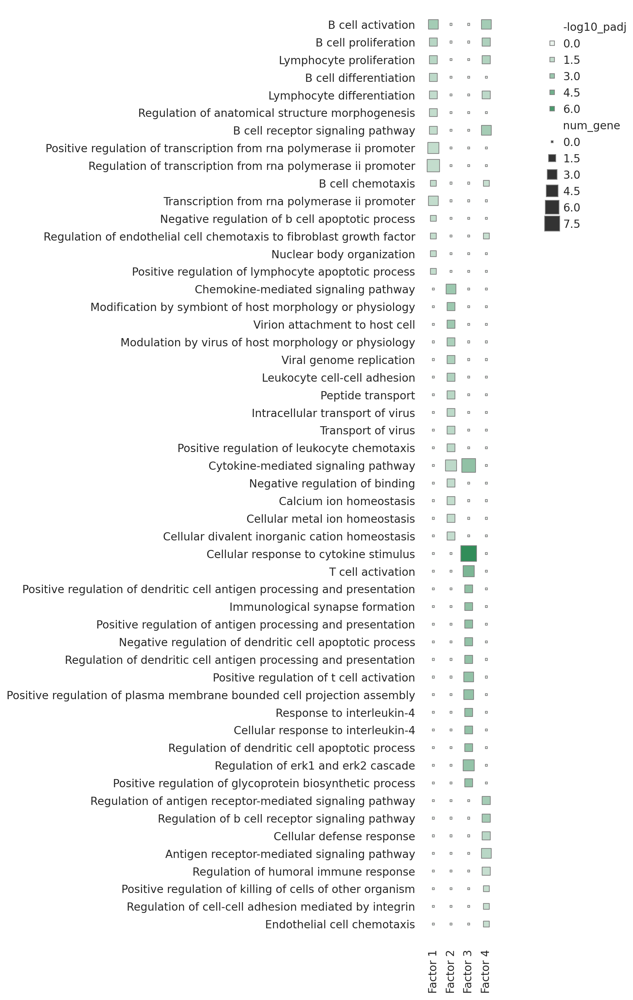

In [1138]:
## draw combined go results
draw_go_combine(wdf12, draw_comps, dpi=200, sizes=(5,300), height=15,
                hue_norm=(0,np.ceil(wdf12['-log10_padj'].max())), 
                size_norm=(0,wdf12['num_gene'].max()),
                fs=12, mx=0.2, my=0.02, leg_pos=(0.8,0.98), title=None)

In [1133]:
## ora
ora_comp = 'comp3'
ora_u_thres = 0.05
clist = vdf.loc[vdf[ora_comp] > 0.2].index.tolist()
print(clist)
glist = udf.loc[udf[ora_comp] > ora_u_thres].index.tolist()
print(len(glist))
enr_res = gseapy.enrichr(gene_list=glist,organism='Human',gene_sets=['GO_Biological_Process_2018'],cutoff = 0.1)
enr_res.res2d.loc[enr_res.res2d['Adjusted P-value']<0.05,['Term','Overlap','P-value','Adjusted P-value','Genes']]

['DC', 'T', 'T_naive']
97


,Term,Overlap,P-value,Adjusted P-value,Genes
0,cellular response to cytokine stimulus (GO:007...,21/456,4.207383e-15,4.539766e-12,STAT5A;STAT5B;CDKN1A;CCL22;SELPLG;STAT1;LEF1;T...
1,cytokine-mediated signaling pathway (GO:0019221),23/633,2.723336e-14,1.469240e-11,STAT5A;STAT5B;IFITM1;CDKN1A;CCL22;STAT1;FLT3LG...
2,T cell activation (GO:0042110),10/88,1.479253e-11,5.320380e-09,DPP4;CD4;IRF4;CD7;CD28;CD3G;CCR7;CCL19;CD3E;LAT
3,positive regulation of cytokine production (GO...,11/220,9.648482e-09,2.602678e-06,PTGER4;CD40LG;CD6;CD28;RARA;CCR7;CCL19;TMEM173...
4,response to cytokine (GO:0034097),8/138,3.612099e-07,7.038198e-05,IFITM1;STAT1;LAMP3;LEF1;PRKCA;CCR7;IL6R;IL18R1
5,regulation of immune response (GO:0050776),10/251,3.913734e-07,7.038198e-05,IFITM1;CD40LG;SELL;KLRB1;IRF4;CD3G;CD247;CD3E;...
6,positive regulation of interleukin-4 productio...,4/15,6.810789e-07,9.186052e-05,CD40LG;IRF4;CD28;RARA
7,regulation of interleukin-4 production (GO:003...,4/15,6.810789e-07,9.186052e-05,CD40LG;LEF1;CD28;RARA
8,positive regulation of T cell activation (GO:0...,6/68,9.558206e-07,1.145923e-04,CD40LG;CD6;CD28;CCR7;CCL19;CD3E
9,positive regulation of MAPK cascade (GO:0043410),10/289,1.411686e-06,1.523209e-04,CD4;CCL22;GLIPR2;SEMA4C;ADAM8;PRKCA;CCR7;ARRB2...


<Axes: title={'center': 'T: comp1 (u > 0.05)'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

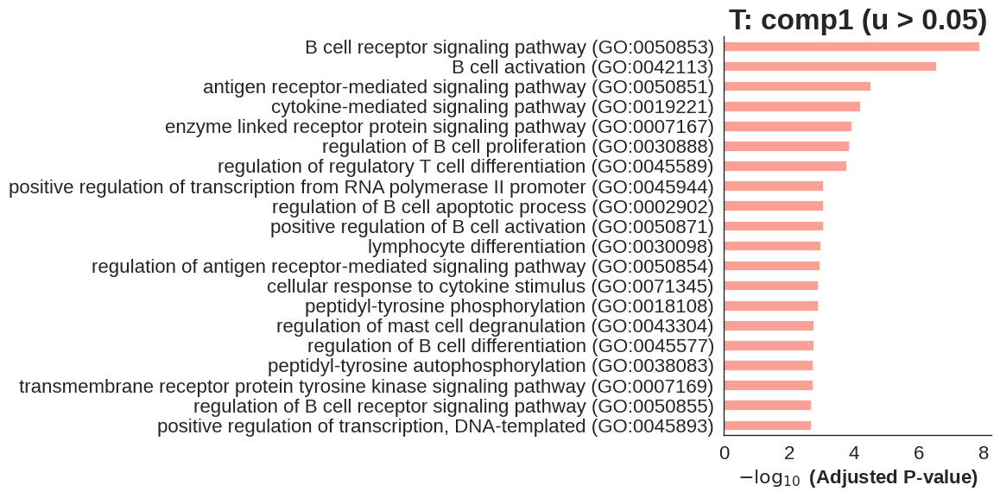

In [97]:
gseapy.barplot(enr_res.res2d,title=f'{target_ct}: {ora_comp} (u > {ora_u_thres})', top_term=20, cutoff=0.05)

## B_mem

In [1200]:
## run method
target_ct = 'B_mem'
target_ct_abbr = target_ct
use_cov_test_genes = True
udf, vdf, meta = run_method(crop, target_ct,  target_ct_abbr, self=True,
                       sigma=20, cutoff=0.05, sort_comp_by_corr=False,
                       n_hvg=3000, cov_thres=0.05, cov_test_null=True,
                       use_cov_test_genes=use_cov_test_genes,
                       cca_comp=10, px=0.6, pz=0.4)

***** Niche matrix *****
13 cell_types.
num_cell_ID: (95969, 13).
Use other 13 cell types.
11403 B_mem, 95969 cells in total.

***** Cov test *****
sparkx_X: (2998, 11403); sparkx_N: (11403, 13)
2997 / 2998 genes have pvalue.
Cov test on permuted data...
526 genes with p_adj < 0.05.
Use all 526 genes with p_adj < 0.05.

***** CCA *****
cca_X: (11403, 526); cca_N: (11403, 13)
Nonneg CCA cors: [0.584 0.548 0.535 0.438 0.323 0.396 0.308 0.356 0.24  0.3  ]
udf: (526, 10); vdf: (13, 10).

B_mem: Finished in 34.6s.


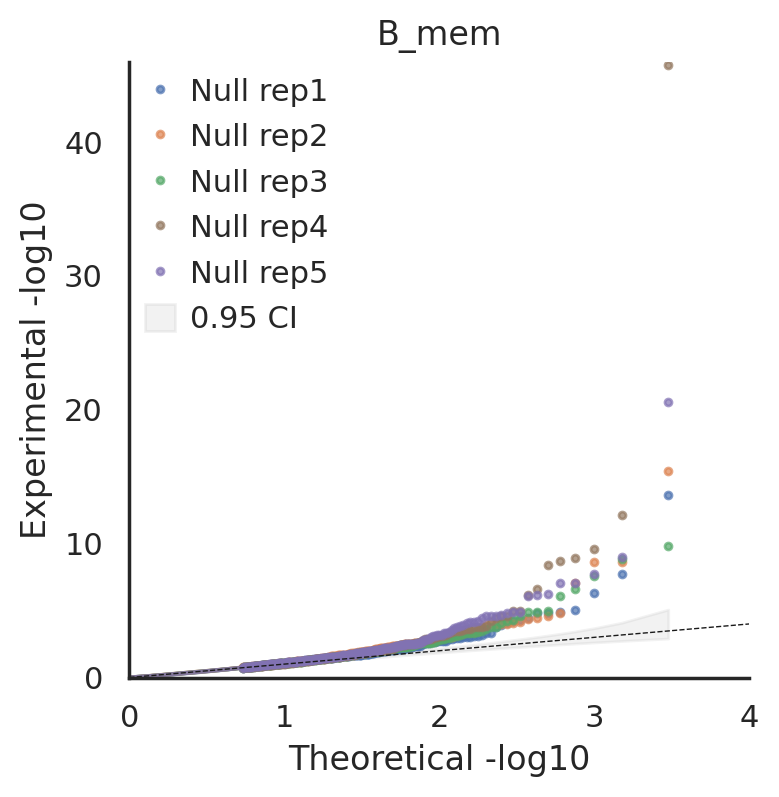

In [1201]:
## qqplot: null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'][1:], [f'Null rep{i}' for i in range(1,6)], 
       color=['C0', 'C1', 'C2', 'C5', 'C4'], shape=['.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

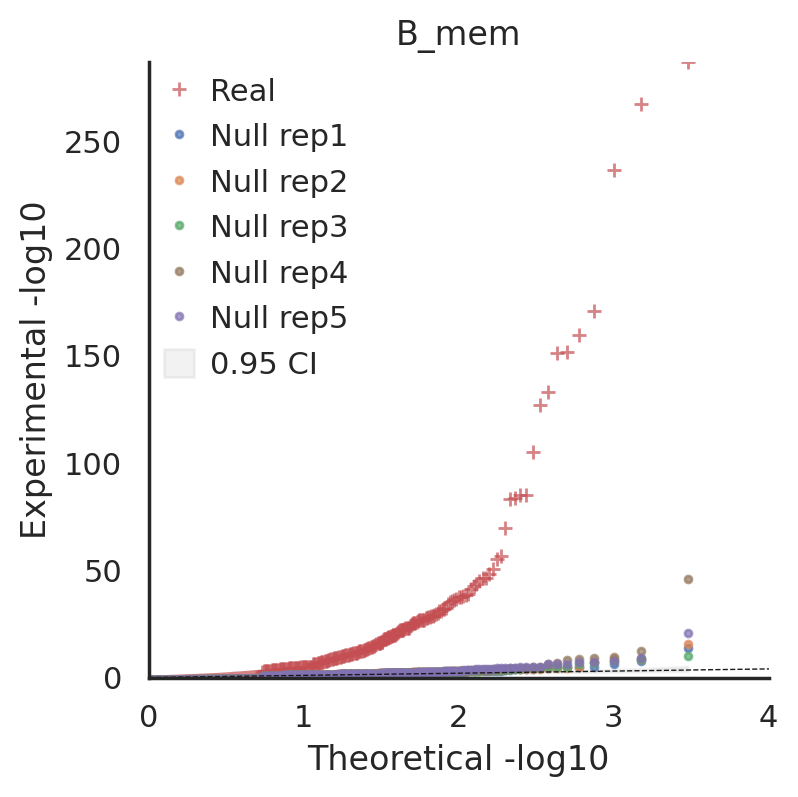

In [1202]:
## qqplot: real and null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'], ['Real']+[f'Null rep{i}' for i in range(1,6)], 
       color=['C3', 'C0', 'C1', 'C2', 'C5', 'C4'], shape=['+','.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

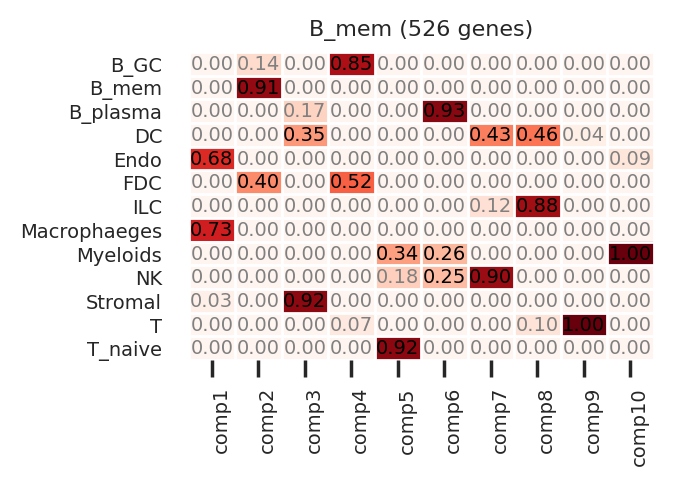

In [1203]:
## v heatmap
sns.set_theme(style="white")
draw_v_heatmap(vdf, figsize=(3,2), title=f'{target_ct} ({len(udf)} genes)')

In [1204]:
## select comps
draw_comps = [1,2,4,5]

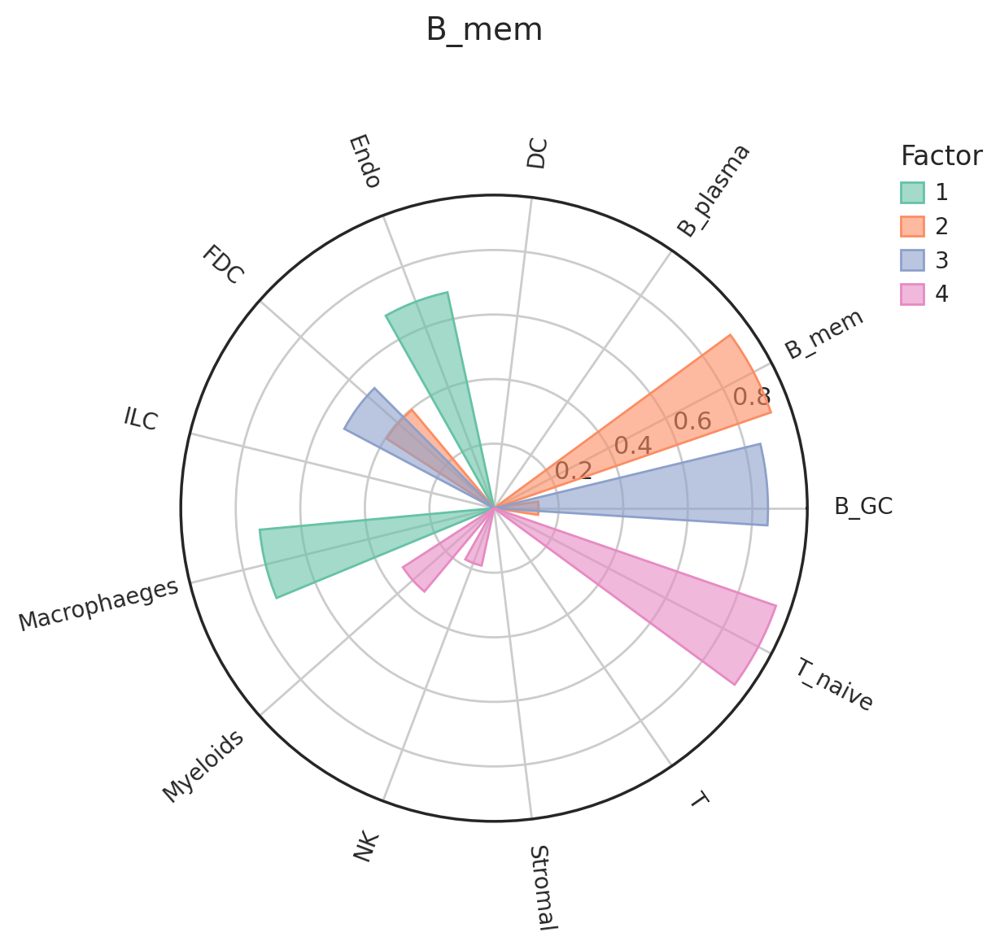

In [1205]:
## v circular
sns.set_theme(style='white')
draw_v_circular(vdf, draw_comps, v_thres=0.1, cmap=mpl.colormaps['Set2'], figsize=(5,5), dpi=200, title=target_ct)

In [1206]:
## niche scores
XY_loc_df = compute_score(crop, udf, vdf, target_ct, meta['N_target'], meta['loc_target'], meta['use_group_ids'])

Computed niche-related scores: XY_loc_df (11403, 560).


In [370]:
## save result
save_objs = {'udf': udf,
             'vdf': vdf,
             'meta': meta,
             'XY_loc_df': XY_loc_df}
filename = f'crop{crop_id}_{target_ct}.pkl'
with open(f'{save_dir}/{filename}', 'wb') as f:
    pickle.dump(save_objs, f)

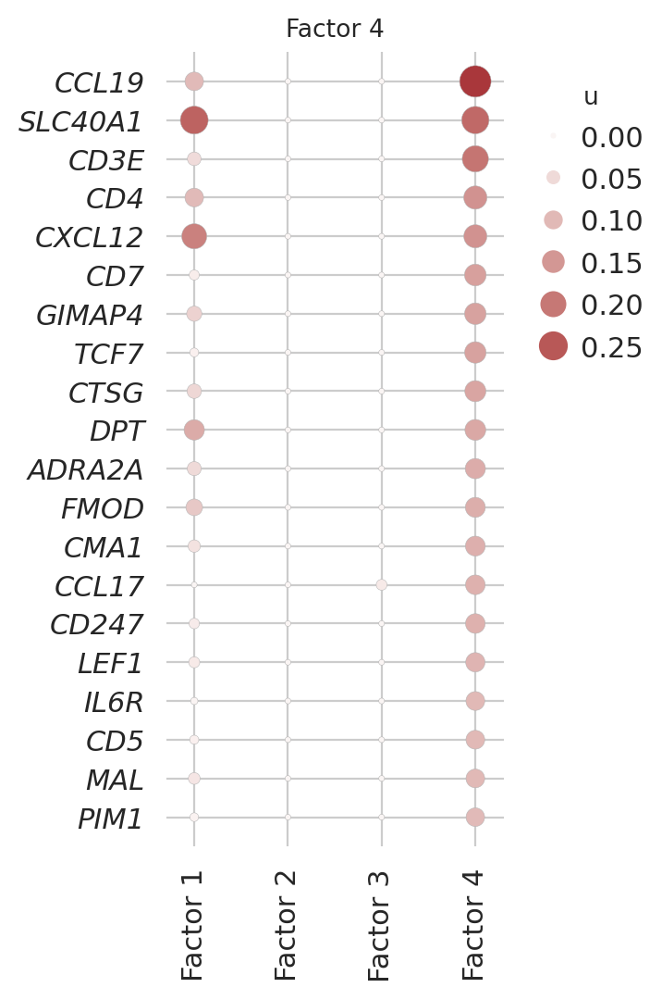

In [1234]:
## u dotmap
focus_comp = 5
n_top_gene = 20
h = 0.25 * n_top_gene
u_title = f"Factor {draw_comps.index(focus_comp)+1}"
xticklabels = [f"Factor {x}" for x in range(1,len(draw_comps)+1)]
draw_u_dotmap(udf, focus_comp, draw_comps, n_top_gene, (5, 150), xticklabels,
                fs=11, h=h, w=3, title=u_title, mx=0.1, my=0.04, leg_pos=(1.1,0.95), dpi=200)

In [1239]:
## kde diff: concord
kde_comp = 4
t0 = time.time()
Z, lims, draw_ids = kde_diff(XY_loc_df, kde_comp, score='concord', z_quantile=0.99, bw=20)
print(f'KDE diff: {time.time() - t0:.1f}s')

KDE diff: 106.1s


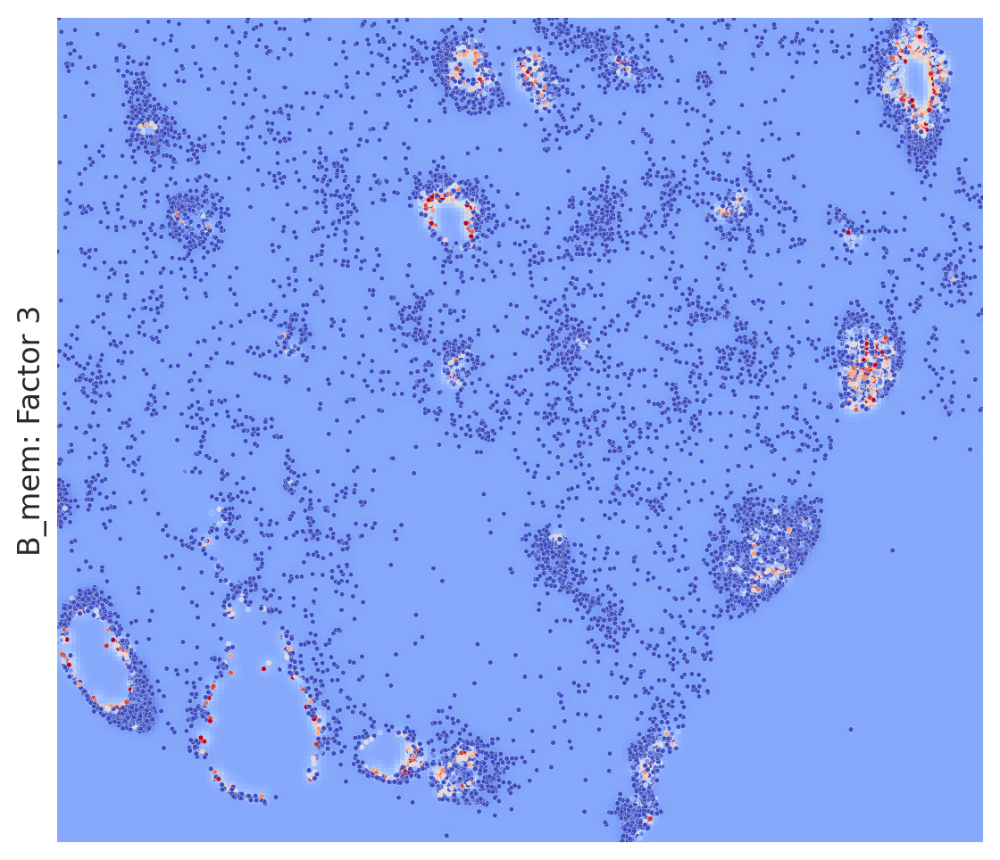

In [1240]:
## kde diff: concord
draw_kde_diff(XY_loc_df, kde_comp, target_ct, Z, lims, draw_ids, score='concord',
                  use_quant=0.99, draw_points=True, cmap=mpl.colormaps['coolwarm'], 
                  ylabel=f'{target_ct}: Factor {draw_comps.index(kde_comp)+1}', fs=12, title=None, figsize=(7, 6), dpi=200)

In [1229]:
## sub cell type count of one factor
subct_comp = 5
score_df = XY_loc_df.copy()
subcts = [x for x in score_df.sub_cell_type.unique() if x.startswith('B')]
count_df = sub_ct_enrich(subct_comp, score_df, subcts, score='concord', q1=0.9, q2=0.95)
count_df

,base,obs_high_09,obs_high_095,exp_high_09,exp_high_095,fold_09,fold_095
sub_cell_type,,,,,,,
B_IFN,1027,103,64,102,51,1.009804,1.254902
B_preGC,954,88,57,95,47,0.926316,1.212766
B_mem,7748,776,384,775,387,1.001290,0.992248
B_naive,1435,150,63,143,71,1.048951,0.887324
B_activated,239,24,3,23,11,1.043478,0.272727


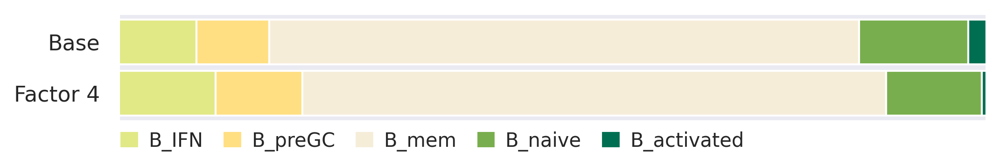

In [1230]:
## sub cell type proportion of this factor
sns.set_theme(style="darkgrid")
# colors = mpl.colormaps['Set2'].colors
color_map = {'B_activated': '#006F51',
             'B_naive': '#78ae4d',
             'B_IFN': '#e1e986',
             'B_preGC': '#ffdf82',
             'B_mem': '#f6edd9'}
colors = [color_map[k] for k in count_df.index.tolist()]
draw_sub_ct_prop(count_df, alphabet=False, figsize=(8,1), dpi=300, h=0.35, yticks=[0, 0.4], 
                     yticklabels=['Base', f'Factor {draw_comps.index(subct_comp)+1}'], colors=colors, ylim=(-0.22,0.62))

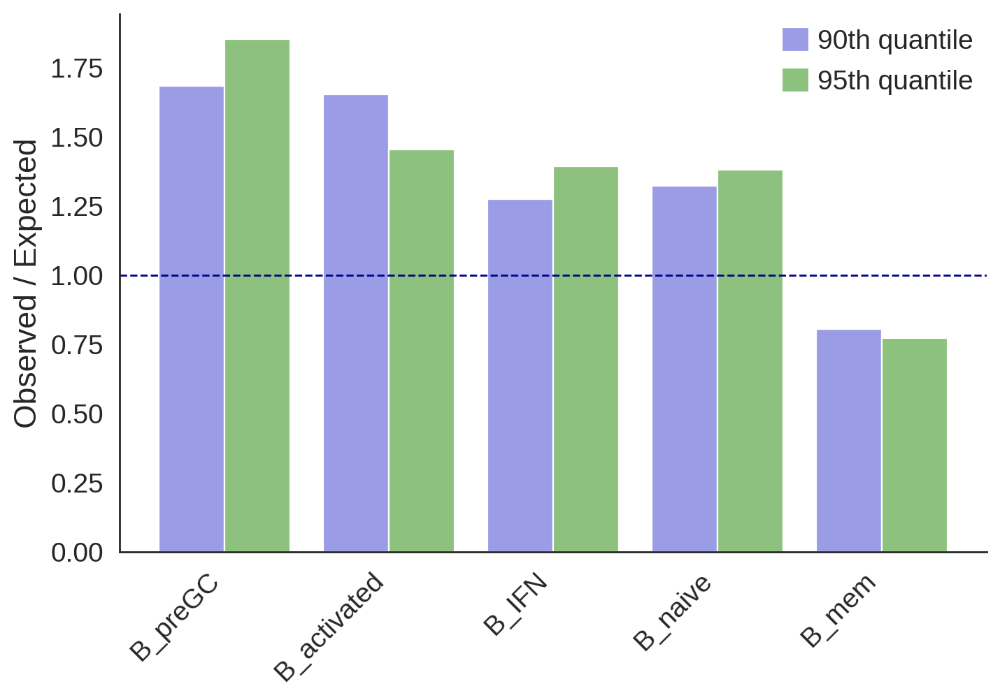

In [393]:
## enrichment folds
draw_sub_ct_enrich(count_df, figsize=(8,5), dpi=200, fs=14, width=0.4, alpha=1, title=None)

In [1213]:
## combine go results
u_thres, u_top = [0.05, 0.05, 0.05, 0.05], None
# u_thres, u_top = None, 15
wdf12 = go_combine(udf, vdf, draw_comps, u_thres=u_thres, u_top=u_top, pval_thres=0.05, n_top=15, enrichr_cutoff=0.1)
print(wdf12['-log10_padj'].min(),round(wdf12['-log10_padj'].max(),1),wdf12['num_gene'].min(),round(wdf12['num_gene'].max(),1))

1 ['Endo', 'Macrophaeges'] 98 15
2 ['B_mem', 'FDC'] 101 15
4 ['B_GC', 'FDC'] 89 15
5 ['Myeloids', 'T_naive'] 106 15
0.0 10.1 0.0 24.0


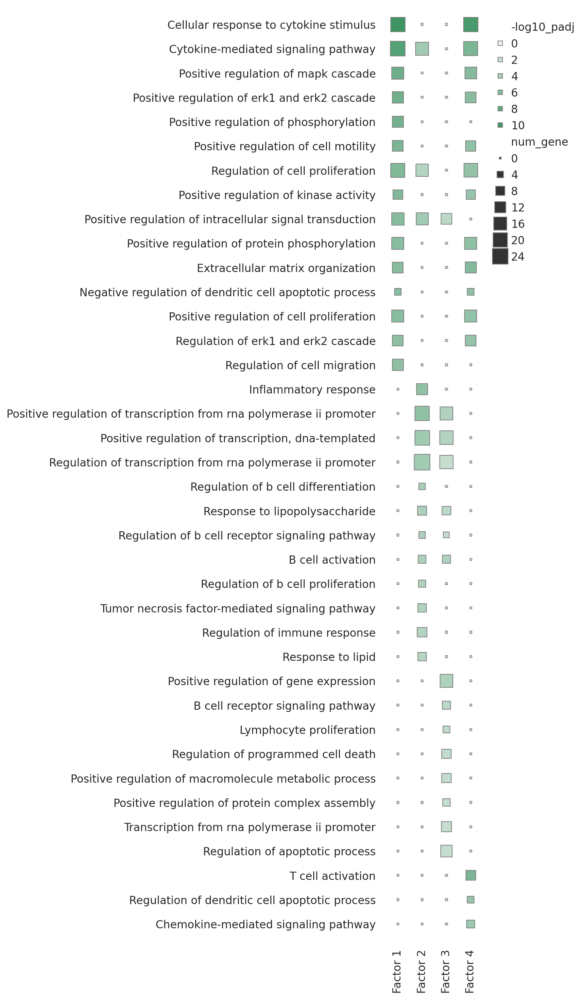

In [1214]:
## draw combined go results
draw_go_combine(wdf12, draw_comps, dpi=200, sizes=(5,300), height=15,
                hue_norm=(0,np.ceil(wdf12['-log10_padj'].max())), 
                size_norm=(0,wdf12['num_gene'].max()),
                fs=12, mx=0.2, my=0.02, leg_pos=(0.76,0.98), title=None)

In [1212]:
## ora
ora_comp = 'comp4'
ora_u_thres = 0.05
clist = vdf.loc[vdf[ora_comp] > 0.2].index.tolist()
print(clist)
glist = udf.loc[udf[ora_comp] > ora_u_thres].index.tolist()
glist = udf.sort_values(ora_comp, ascending=False).iloc[:20].index.tolist()
print(len(glist))
enr_res = gseapy.enrichr(gene_list=glist,organism='Human',gene_sets=['GO_Biological_Process_2018'],cutoff = 0.1)
enr_res.res2d.loc[enr_res.res2d['Adjusted P-value']<0.05,['Term','Overlap','P-value','Adjusted P-value','Genes']]

['B_GC', 'FDC']
20


,Term,Overlap,P-value,Adjusted P-value,Genes
0,inflammatory response (GO:0006954),4/252,0.000102,0.019815,NGFR;EPHX2;TNFRSF9;CXCL13
1,response to molecule of bacterial origin (GO:0...,3/98,0.000122,0.019815,NGFR;TNFRSF9;CXCL13
2,urogenital system development (GO:0001655),2/22,0.000217,0.019815,ITGB4;SOX9
3,regulation of pri-miRNA transcription from RNA...,2/26,0.000304,0.019815,NGFR;SOX9
4,cytokine-mediated signaling pathway (GO:0019221),5/633,0.000326,0.019815,NGFR;FCER2;VCAM1;TNFRSF9;CXCL13
5,response to lipid (GO:0033993),3/140,0.000351,0.019815,NGFR;TNFRSF9;CXCL13
6,response to lipopolysaccharide (GO:0032496),3/155,0.000472,0.022878,NGFR;TNFRSF9;CXCL13
7,regulation of cell proliferation (GO:0042127),5/740,0.000667,0.028281,NGFR;TNFRSF9;S1PR3;SOX9;CXCL13
8,B cell differentiation (GO:0030183),2/52,0.001223,0.046048,CD79A;VCAM1


In [ ]:
gseapy.barplot(enr_res.res2d,title=f'{target_ct}: {ora_comp} (u > {ora_u_thres})', top_term=20, cutoff=0.05)

## B_GC

In [1272]:
## run method
target_ct = 'B_GC'
target_ct_abbr = target_ct
use_cov_test_genes = True
udf, vdf, meta = run_method(crop, target_ct,  target_ct_abbr, self=True,
                       sigma=20, cutoff=0.05, sort_comp_by_corr=False, max_cand_genes=500,
                       n_hvg=3000, cov_thres=0.05, cov_test_null=True,
                       use_cov_test_genes=use_cov_test_genes,
                       cca_comp=12, px=0.6, pz=0.5)

***** Niche matrix *****
13 cell_types.
num_cell_ID: (95969, 13).
Use other 13 cell types.
10574 B_GC, 95969 cells in total.

***** Cov test *****
sparkx_X: (2996, 10574); sparkx_N: (10574, 13)
2995 / 2996 genes have pvalue.
Cov test on permuted data...
1255 genes with p_adj < 0.05.
Use top 500 genes with p_adj < 0.05.

***** CCA *****
cca_X: (10574, 500); cca_N: (10574, 13)
Nonneg CCA cors: [0.653 0.771 0.504 0.68  0.525 0.533 0.426 0.465 0.489 0.388 0.378 0.   ]
udf: (500, 12); vdf: (13, 12).

B_GC: Finished in 36.6s.


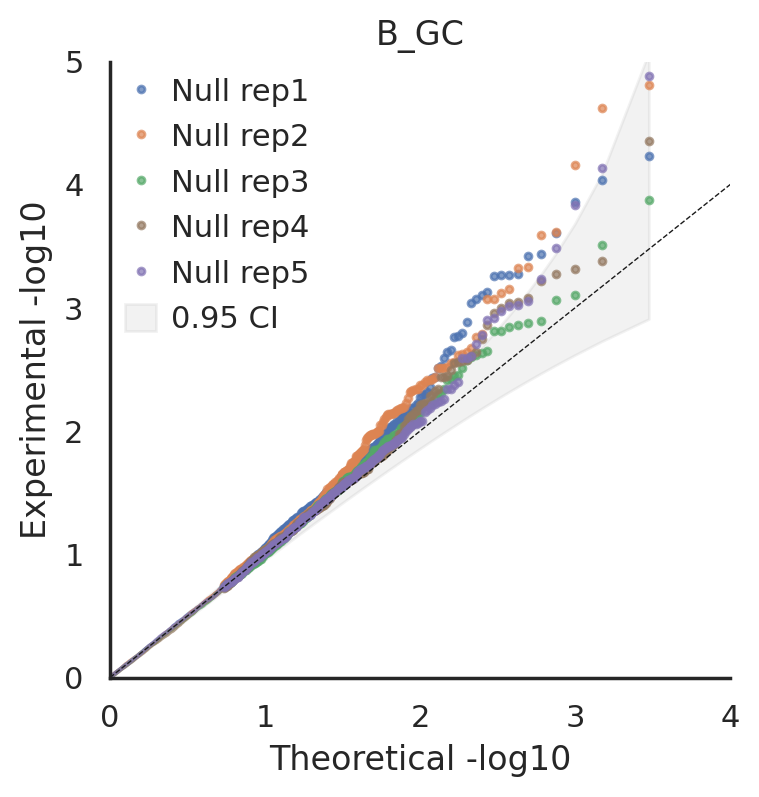

In [1273]:
## qqplot: null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'][1:], [f'Null rep{i}' for i in range(1,6)], 
       color=['C0', 'C1', 'C2', 'C5', 'C4'], shape=['.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

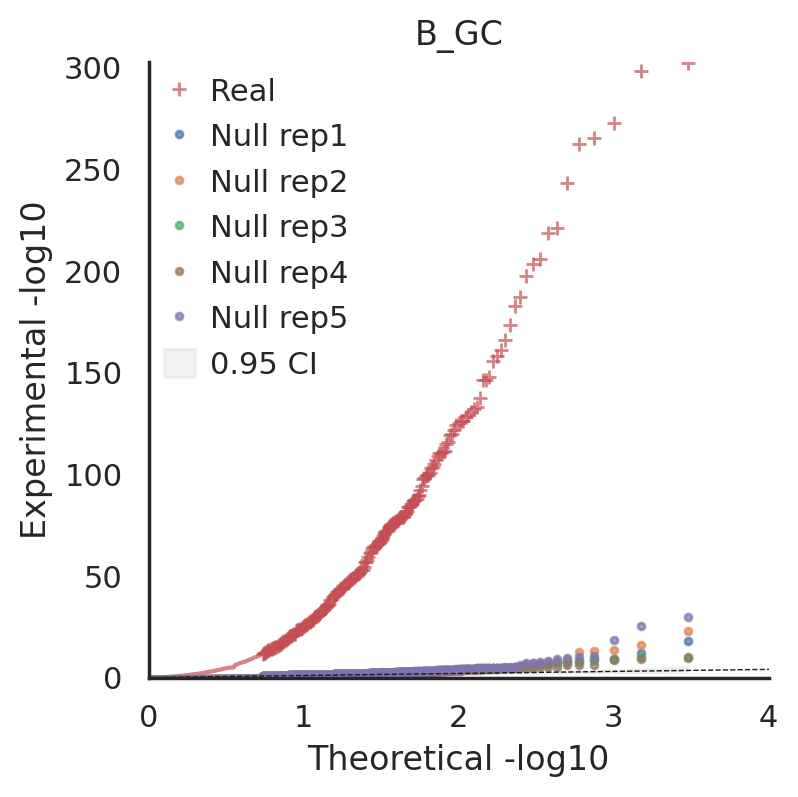

In [1161]:
## qqplot: real and null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=200)
qqplot(meta['cov_test_qqplot_data'], ['Real']+[f'Null rep{i}' for i in range(1,6)], 
       color=['C3', 'C0', 'C1', 'C2', 'C5', 'C4'], shape=['+','.','.','.','.','.'], distribution='beta', ax=ax, title=target_ct)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

In [1270]:
np.random.seed(3)
arr = np.arange(9)
arr2 = arr.copy()
np.random.shuffle(arr)
arr.reshape(3,3)
arr2.reshape(3,3).ravel()

array([0, 1, 2, 3, 4, 5, 6, 7, 8])

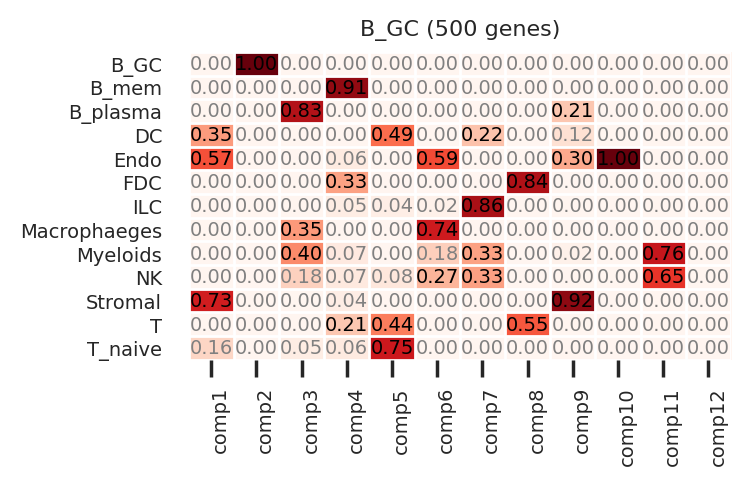

In [1246]:
## v heatmap
sns.set_theme(style="white")
draw_v_heatmap(vdf, figsize=(3.5,2), title=f'{target_ct} ({len(udf)} genes)')

In [1243]:
## select comps
draw_comps = [2,3,4,12]

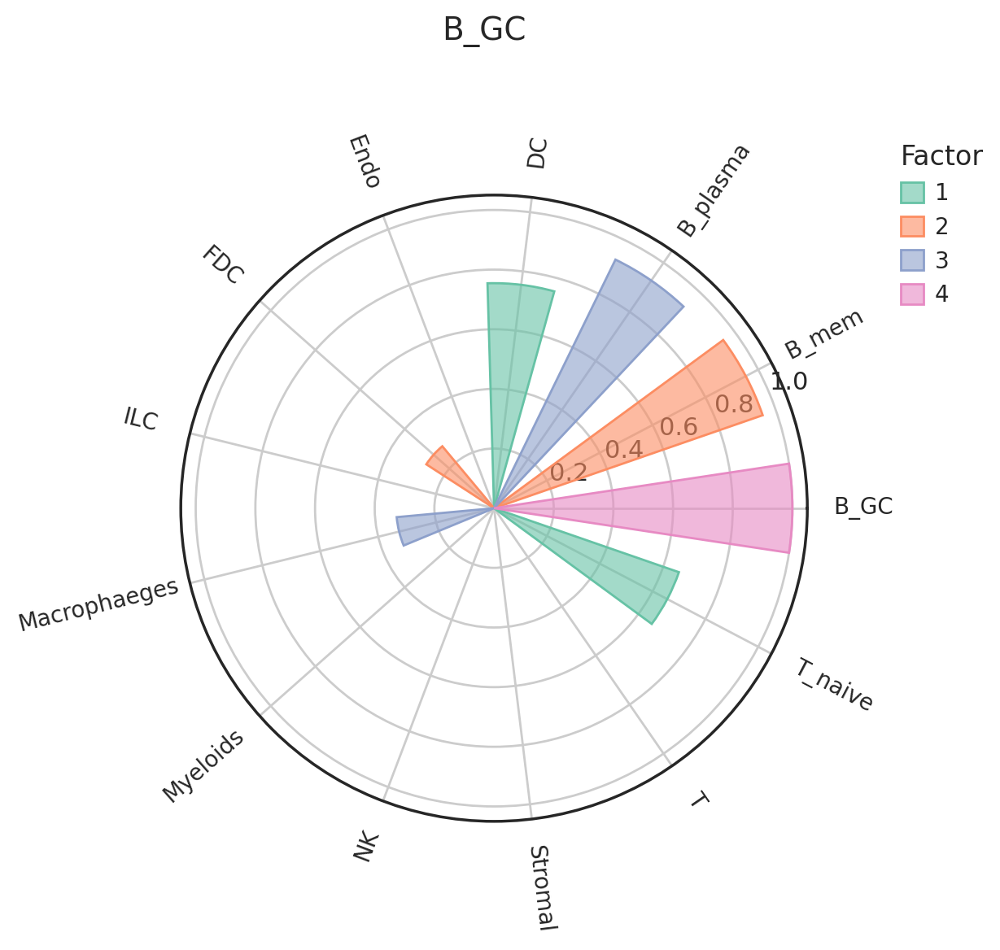

In [1244]:
## v circular
sns.set_theme(style='white')
draw_v_circular(vdf, draw_comps, v_thres=0.2, cmap=mpl.colormaps['Set2'], figsize=(5,5), dpi=200, title=target_ct)

In [1177]:
## niche scores
XY_loc_df = compute_score(crop, udf, vdf, target_ct, meta['N_target'], meta['loc_target'], meta['use_group_ids'])

Computed niche-related scores: XY_loc_df (10574, 540).


In [751]:
## save result
save_objs = {'udf': udf,
             'vdf': vdf,
             'meta': meta,
             'XY_loc_df': XY_loc_df}
filename = f'crop{crop_id}_{target_ct}.pkl'
with open(f'{save_dir}/{filename}', 'wb') as f:
    pickle.dump(save_objs, f)

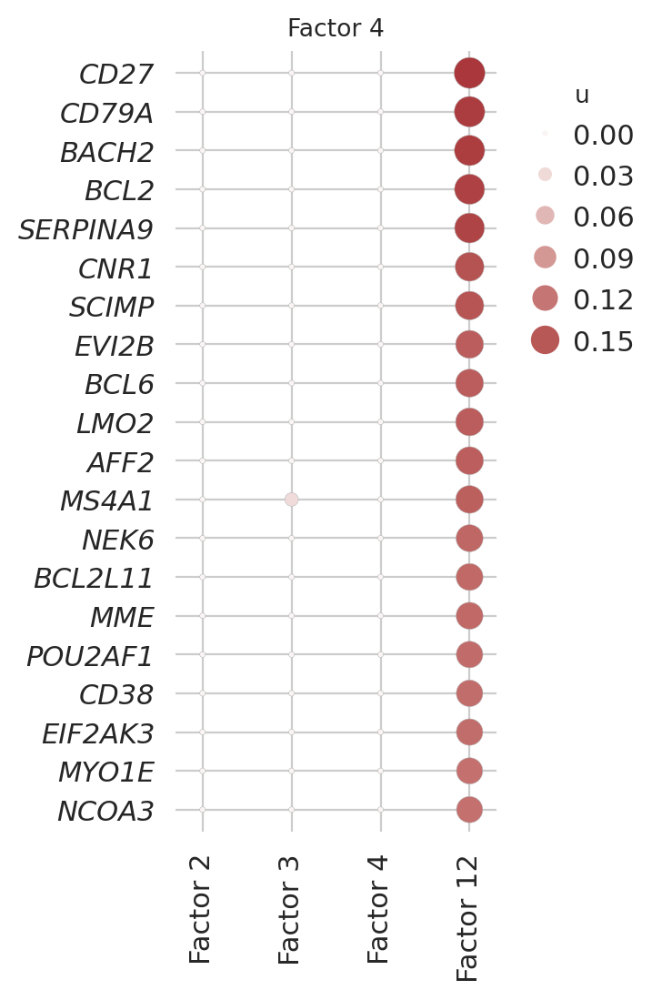

In [1199]:
## u dotmap
focus_comp = 12
n_top_gene = 20
h = 0.25 * n_top_gene
u_title = f"Factor {draw_comps.index(focus_comp)+1}"
xticklabels = [f"Factor {x}" for x in draw_comps]
draw_u_dotmap(udf, focus_comp, draw_comps, n_top_gene, (5, 150), xticklabels,
                fs=11, h=h, w=3, title=u_title, mx=0.1, my=0.03, leg_pos=(1.1,0.95), dpi=200)

In [1186]:
## kde diff: concord
kde_comp = 12
t0 = time.time()
Z, lims, draw_ids = kde_diff(XY_loc_df, kde_comp, score='concord', z_quantile=0.99, bw=20)
print(f'KDE diff: {time.time() - t0:.1f}s')

KDE diff: 67.0s


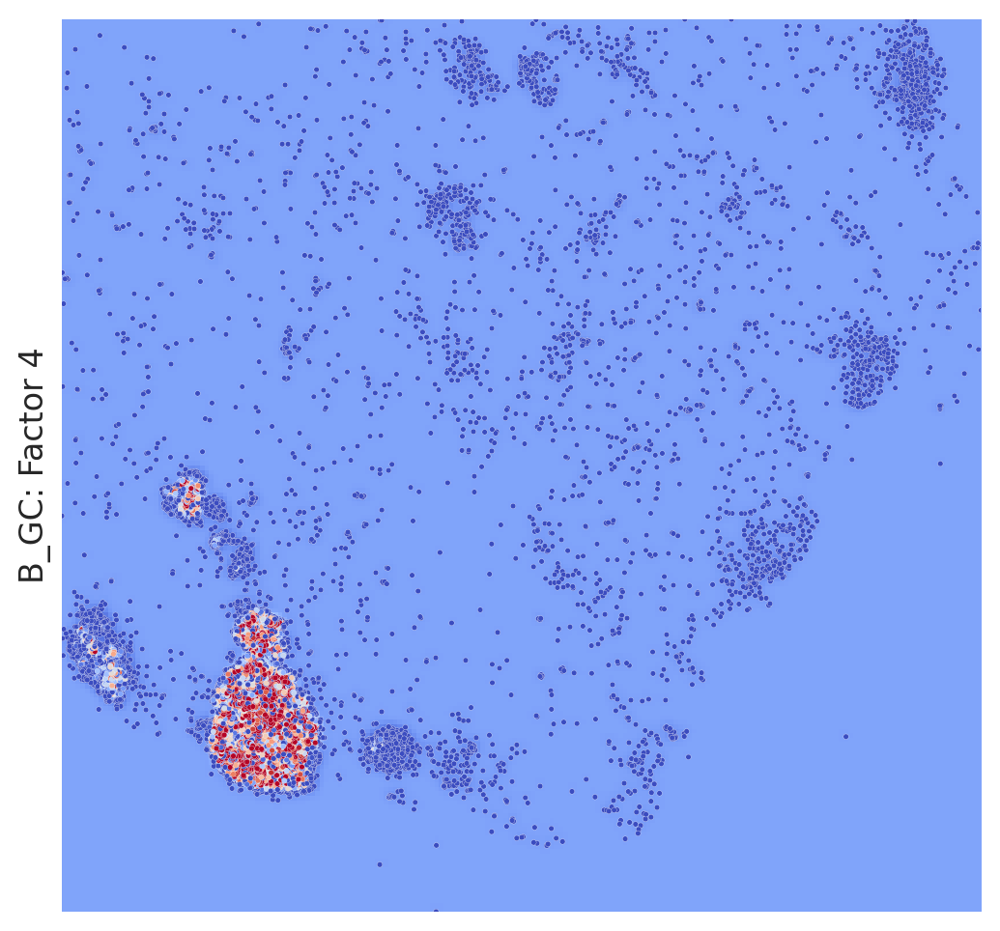

In [1187]:
## kde diff: concord
draw_kde_diff(XY_loc_df, kde_comp, target_ct, Z, lims, draw_ids, score='concord',
                  use_quant=0.99, draw_points=True, cmap=mpl.colormaps['coolwarm'], 
                  ylabel=f'{target_ct}: Factor {draw_comps.index(kde_comp)+1}', fs=12, title=None, figsize=(7, 6), dpi=200)

In [1194]:
## sub cell type count of one factor
subct_comp = 12
score_df = XY_loc_df.copy()
subcts = [x for x in score_df.sub_cell_type.unique() if x.startswith('B')]
count_df = sub_ct_enrich(subct_comp, score_df, subcts, score='concord', q1=0.9, q2=0.95)
count_df

,base,obs_high_09,obs_high_095,exp_high_09,exp_high_095,fold_09,fold_095
sub_cell_type,,,,,,,
B_GC_DZ,3017,562,304,301,150,1.867110,2.026667
B_GC_LZ,5027,451,208,502,251,0.898406,0.828685
B_GC_prePB,251,18,6,25,12,0.720000,0.500000
B_Cycling,2279,27,11,228,114,0.118421,0.096491


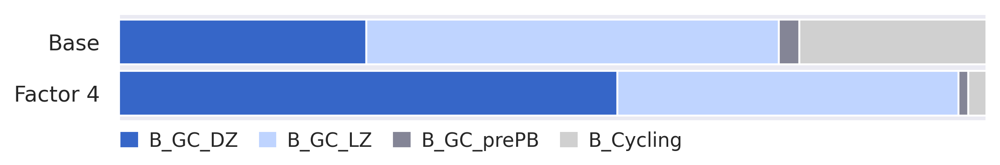

In [1195]:
## sub cell type proportion of this factor
sns.set_theme(style="darkgrid")
# colors = mpl.colormaps['Set2'].colors
color_map = {'B_GC_LZ': '#bfd4ff',
             'B_GC_prePB': '#848596',
             'B_GC_DZ': '#3666C8',
             'B_Cycling': '#D0D0D0'}
colors = [color_map[k] for k in count_df.index.tolist()]
draw_sub_ct_prop(count_df, alphabet=False, figsize=(8,1), dpi=300, h=0.35, yticks=[0, 0.4], 
                     yticklabels=['Base', f'Factor {draw_comps.index(subct_comp)+1}'], colors=colors, ylim=(-0.22,0.62))

In [ ]:
## enrichment folds
draw_sub_ct_enrich(count_df, figsize=(8,5), dpi=200, fs=14, width=0.4, alpha=1, title=None)

In [1168]:
## combine go results
# u_thres, u_top = [0.05, 0.05, 0.05, 0.05], None
u_thres, u_top = None, 15
wdf12 = go_combine(udf, vdf, draw_comps, u_thres=u_thres, u_top=u_top, pval_thres=0.05, n_top=15, enrichr_cutoff=0.1)
print(wdf12['-log10_padj'].min(),round(wdf12['-log10_padj'].max(),1),wdf12['num_gene'].min(),round(wdf12['num_gene'].max(),1))

2 ['DC', 'T_naive'] 15 15
3 ['B_mem', 'FDC'] 15 15
4 ['B_plasma', 'Macrophaeges'] 15 15
12 ['B_GC'] 15 15
0.0 3.6 0.0 5.0


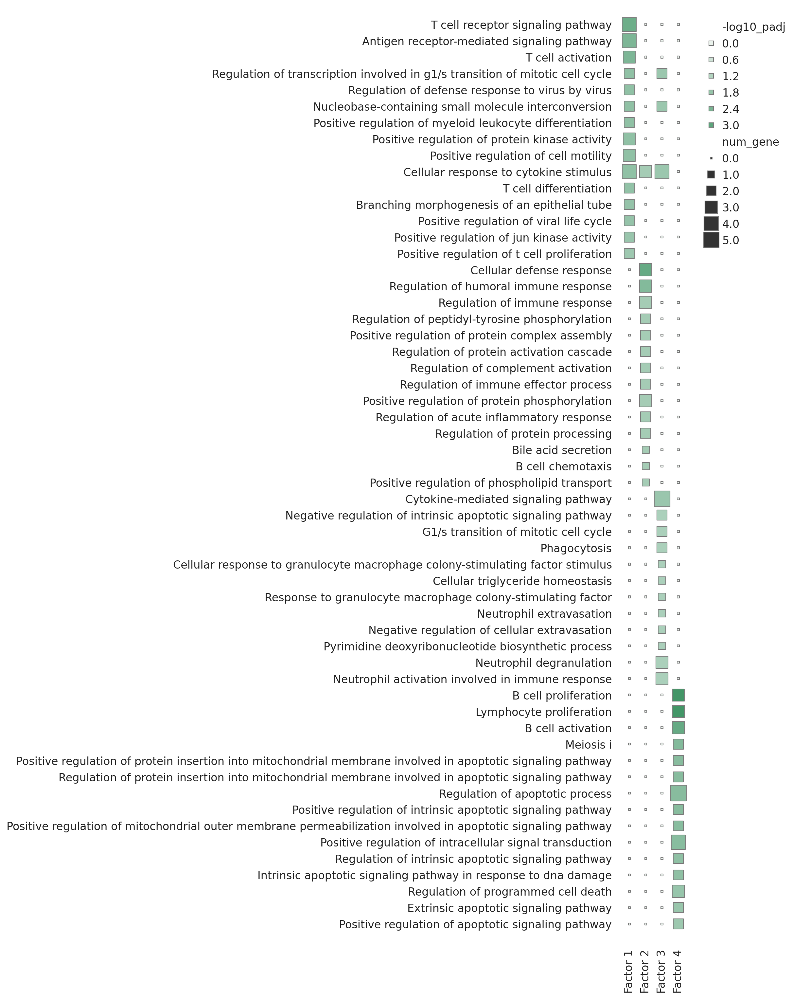

In [1171]:
## draw combined go results
draw_go_combine(wdf12, draw_comps, dpi=200, sizes=(5,300), height=15,
                hue_norm=(0,np.ceil(wdf12['-log10_padj'].max())), 
                size_norm=(0,wdf12['num_gene'].max()),
                fs=12, mx=0.2, my=0.02, leg_pos=(0.84,0.98), title=None)

In [834]:
## ora
ora_comp = 'comp4'
ora_u_top = 15
ora_u_thres = 0.05
clist = vdf.loc[vdf[ora_comp] > 0.2].index.tolist()
print(clist)
glist = udf.loc[udf[ora_comp] > ora_u_thres].index.tolist()
tmp = udf.sort_values(ora_comp, ascending=False).iloc[:ora_u_top]
glist = tmp.index.tolist()
print(len(glist), tmp[ora_comp].min(), tmp[ora_comp].max())
enr_res = gseapy.enrichr(gene_list=glist,organism='Human',gene_sets=['GO_Biological_Process_2018'],cutoff = 0.1)
enr_res.res2d.loc[enr_res.res2d['Adjusted P-value']<0.1,['Term','Overlap','P-value','Adjusted P-value','Genes']]

['B_plasma', 'Endo']
15 0.10538245263050551 0.31513098349730884


,Term,Overlap,P-value,Adjusted P-value,Genes
0,regulation of transcription involved in G1/S t...,3/26,8.781599e-07,0.000276,PCNA;RRM2;TYMS
1,G1/S transition of mitotic cell cycle (GO:0000...,3/105,6.110477e-05,0.009593,PCNA;RRM2;TYMS
2,phagocytosis (GO:0006909),3/135,1.289545e-04,0.012617,PRTN3;CD302;ELANE
3,acute inflammatory response (GO:0002526),2/28,1.962294e-04,0.012617,IL6R;ELANE
4,positive regulation of cell proliferation (GO:...,4/424,2.258134e-04,0.012617,XBP1;PRTN3;IL6R;ELANE
5,nucleobase-containing small molecule interconv...,2/31,2.410801e-04,0.012617,RRM2;TYMS
6,cellular response to cytokine stimulus (GO:007...,4/456,2.981274e-04,0.013373,XBP1;F13A1;PRTN3;IL6R
7,positive regulation of smooth muscle cell prol...,2/37,3.443935e-04,0.013517,IL6R;ELANE
8,positive regulation of interleukin-6 productio...,2/43,4.657368e-04,0.015314,XBP1;IL6R
9,regulation of smooth muscle cell proliferation...,2/44,4.877036e-04,0.015314,IL6R;ELANE


<Axes: title={'center': 'B_GC: comp2 (u > 0.1)'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

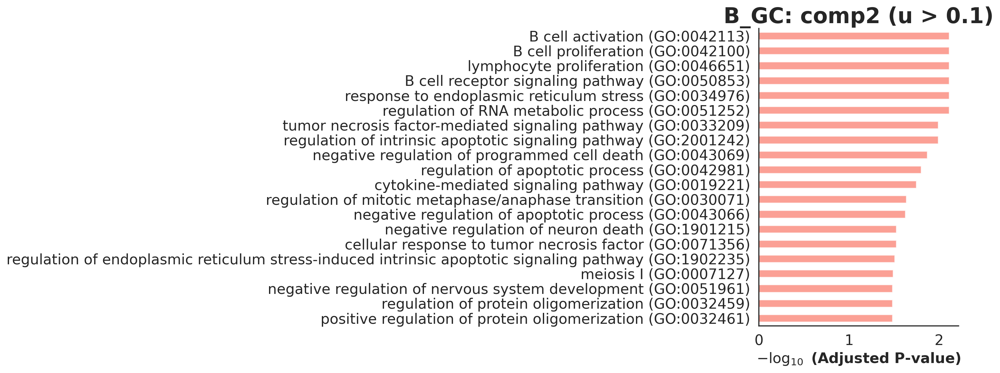

In [760]:
gseapy.barplot(enr_res.res2d,title=f'{target_ct}: {ora_comp} (u > {ora_u_thres})', top_term=20, cutoff=0.05)

## B_plasma